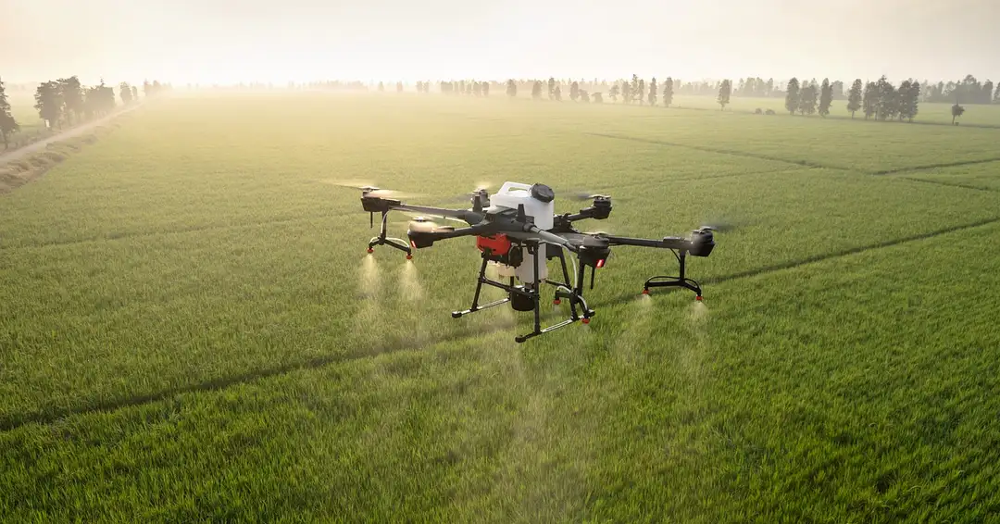


# Predictive System Using Metar Data

Main database: https://mesonet.agron.iastate.edu/request/download.phtml?network=BR__ASOS

The IEM maintains an ever growing archive of automated airport weather observations from around the world! These observations are typically called 'ASOS' or sometimes 'AWOS' sensors. A more generic term may be METAR data, which is a term that describes the format the data is transmitted as. This archive simply provides the as-is collection of historical observations, very little quality control is done. More details on this dataset are here: https://mesonet.agron.iastate.edu/info/datasets/metar.html

ASOS User's Guide: https://www.weather.gov/media/asos/aum-toc.pdf

Tools/Libaries: Here (https://github.com/akrherz/iem/blob/main/scripts/asos/iem_scraper_example.py) is a python script example that automates the download of data from this interface. A community user has contributed R language version of the python script. There is also a riem R package allowing for easy access to this archive.

# Main Libraries

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Numerical libraries
import pandas as pd
import numpy as np

# Visualization
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="ticks", color_codes=True)

# Statistics and Machine Learning
import statistics
from sklearn.model_selection import train_test_split
from sklearn import metrics

# Main Database: 2017-01-01 to 2021-12-31

## 1- Loading Data


**Metadata:**
- station: three or four character site identifier
- valid: timestamp of the observation
- tmpf: Air Temperature in Fahrenheit, typically @ 2 meters
- dwpf: Dew Point Temperature in Fahrenheit, typically @ 2 meters
- relh: Relative Humidity in %
- drct: Wind Direction in degrees from true north
- sknt: Wind Speed in knots
- p01i: One hour precipitation for the period from the observation time to the time of the previous hourly precipitation reset. This varies slightly by site. Values are in inches. This value may or may not contain frozen precipitation melted by some device on the sensor or estimated by some other means. Unfortunately, we do not know of an authoritative database denoting which station has which sensor.
- alti: Pressure altimeter in inches
- mslp: Sea Level Pressure in millibar
- vsby: Visibility in miles
- gust: Wind Gust in knots
- skyc1: Sky Level 1 Coverage
- skyc2: Sky Level 2 Coverage
- skyc3: Sky Level 3 Coverage
- skyc4: Sky Level 4 Coverage
- skyl1: Sky Level 1 Altitude in feet
- skyl2: Sky Level 2 Altitude in feet
- skyl3: Sky Level 3 Altitude in feet
- skyl4: Sky Level 4 Altitude in feet
- wxcodes: Present Weather Codes (space seperated)
- feel: Apparent Temperature (Wind Chill or Heat Index) in Fahrenheit
- ice_accretion_1hr: Ice Accretion over 1 Hour (inches)
- ice_accretion_3hr: Ice Accretion over 3 Hours (inches)
- ice_accretion_6hr: Ice Accretion over 6 Hours (inches)
- peak_wind_gust: Peak Wind Gust (from PK WND METAR remark) (knots)
- peak_wind_drct: Peak Wind Gust Direction (from PK WND METAR remark) (deg)
- peak_wind_time: Peak Wind Gust Time (from PK WND METAR remark)
- metar: unprocessed reported observation in METAR format

**Obs: for Sky Coverage values:**

- FEW - few clouds
- SCT - sparse
- BKN - cloudy
- OVC - overcast

### (i) Raw Data

In [4]:
df_raw = pd.read_csv('SBRP.csv')
df_raw

,station,valid,tmpf,dwpf,relh,drct,sknt,p01i,alti,mslp,...,wxcodes,ice_accretion_1hr,ice_accretion_3hr,ice_accretion_6hr,peak_wind_gust,peak_wind_drct,peak_wind_time,feel,metar,snowdepth
0,SBRP,2017-01-01 00:00,75.2,69.8,83.32,60.0,5.0,0.0,29.97,NaN,...,VCTS,NaN,NaN,NaN,NaN,NaN,NaN,76.34,SBRP 010000Z 06005KT 9999 VCTS FEW035 FEW040CB...,NaN
1,SBRP,2017-01-01 01:00,75.2,69.8,83.32,70.0,4.0,0.0,30.00,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76.34,SBRP 010100Z 07004KT CAVOK 24/21 Q1016,NaN
2,SBRP,2017-01-01 02:00,75.2,69.8,83.32,110.0,2.0,0.0,30.00,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76.34,SBRP 010200Z 11002KT CAVOK 24/21 Q1016,NaN
3,SBRP,2017-01-01 03:00,75.2,69.8,83.32,80.0,3.0,0.0,29.97,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76.34,SBRP 010300Z 08003KT CAVOK 24/21 Q1015,NaN
4,SBRP,2017-01-01 04:00,73.4,69.8,88.51,140.0,3.0,0.0,29.97,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,74.60,SBRP 010400Z 14003KT CAVOK 23/21 Q1015,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43203,SBRP,2021-12-30 19:00,69.8,68.0,94.01,130.0,6.0,0.0,29.83,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.80,SBRP 301900Z 13006KT 7000 SCT010 BKN040 OVC070...,NaN
43204,SBRP,2021-12-30 20:00,71.6,68.0,88.43,120.0,5.0,0.0,29.80,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.60,SBRP 302000Z 12005KT 9999 FEW010 SCT045 OVC070...,NaN
43205,SBRP,2021-12-30 21:00,71.6,68.0,88.43,130.0,7.0,0.0,29.80,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.60,SBRP 302100Z 13007KT CAVOK 22/20 Q1009,NaN
43206,SBRP,2021-12-30 22:00,71.6,68.0,88.43,90.0,3.0,0.0,29.80,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.60,SBRP 302200Z 09003KT 070V130 CAVOK 22/20 Q1009,NaN


In [3]:
df_raw.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43208 entries, 0 to 43207
Data columns (total 30 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   station            43208 non-null  object 
 1   valid              43208 non-null  object 
 2   tmpf               43187 non-null  float64
 3   dwpf               43181 non-null  float64
 4   relh               43134 non-null  float64
 5   drct               41553 non-null  float64
 6   sknt               43185 non-null  float64
 7   p01i               43208 non-null  float64
 8   alti               43155 non-null  float64
 9   mslp               0 non-null      float64
 10  vsby               43190 non-null  float64
 11  gust               178 non-null    float64
 12  skyc1              16439 non-null  object 
 13  skyc2              8061 non-null   object 
 14  skyc3              1665 non-null   object 
 15  skyc4              82 non-null     object 
 16  skyl1              153

### (ii) Filtering by Important Features, Filling Missing Values and Changing DTypes

* **Selecting Features**

In [5]:
df = df_raw.drop(['station','mslp','gust','p01i',
                  'skyc2','skyl2','skyc3','skyl3',
                  'skyc4','skyl4','wxcodes','ice_accretion_1hr',
                  'ice_accretion_3hr','ice_accretion_6hr','peak_wind_gust',
                  'peak_wind_drct','peak_wind_time','snowdepth'],axis=1)
df

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar
0,2017-01-01 00:00,75.2,69.8,83.32,60.0,5.0,29.97,6.21,FEW,3500.0,76.34,SBRP 010000Z 06005KT 9999 VCTS FEW035 FEW040CB...
1,2017-01-01 01:00,75.2,69.8,83.32,70.0,4.0,30.00,6.21,NaN,NaN,76.34,SBRP 010100Z 07004KT CAVOK 24/21 Q1016
2,2017-01-01 02:00,75.2,69.8,83.32,110.0,2.0,30.00,6.21,NaN,NaN,76.34,SBRP 010200Z 11002KT CAVOK 24/21 Q1016
3,2017-01-01 03:00,75.2,69.8,83.32,80.0,3.0,29.97,6.21,NaN,NaN,76.34,SBRP 010300Z 08003KT CAVOK 24/21 Q1015
4,2017-01-01 04:00,73.4,69.8,88.51,140.0,3.0,29.97,6.21,NaN,NaN,74.60,SBRP 010400Z 14003KT CAVOK 23/21 Q1015
...,...,...,...,...,...,...,...,...,...,...,...,...
43203,2021-12-30 19:00,69.8,68.0,94.01,130.0,6.0,29.83,4.35,SCT,1000.0,69.80,SBRP 301900Z 13006KT 7000 SCT010 BKN040 OVC070...
43204,2021-12-30 20:00,71.6,68.0,88.43,120.0,5.0,29.80,6.21,FEW,1000.0,71.60,SBRP 302000Z 12005KT 9999 FEW010 SCT045 OVC070...
43205,2021-12-30 21:00,71.6,68.0,88.43,130.0,7.0,29.80,6.21,NaN,NaN,71.60,SBRP 302100Z 13007KT CAVOK 22/20 Q1009
43206,2021-12-30 22:00,71.6,68.0,88.43,90.0,3.0,29.80,6.21,NaN,NaN,71.60,SBRP 302200Z 09003KT 070V130 CAVOK 22/20 Q1009


* **Missing Values (NaN)**

In [6]:
pd.DataFrame({'Column Name':list(df.columns),
                            'Total of NaN':df.isna().sum().values,
                            'Percentage of NaN':[round((100*x/len(df)),3) for x in df.isna().sum().values]})

,Column Name,Total of NaN,Percentage of NaN
0,valid,0,0.000
1,tmpf,21,0.049
2,dwpf,27,0.062
3,relh,74,0.171
4,drct,1655,3.830
5,sknt,23,0.053
6,alti,53,0.123
7,vsby,18,0.042
8,skyc1,26769,61.954
9,skyl1,27908,64.590


In [5]:
df_raw.skyc1.value_counts()

FEW    6744
SCT    5077
BKN    3068
NSC    1134
OVC     379
VV       37
Name: skyc1, dtype: int64

In [7]:
# Changing DType
df = df.astype({
    'valid':'datetime64[ns]',
    'skyc1':'category',
    'metar':'string'
})

# Filling Missing Values --> https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.fillna.html
values = {'tmpf':df.tmpf.mean(),
          'dwpf':df.dwpf.mean(),
          'relh':df.relh.mean(),
          'drct':statistics.mode(df.drct),
          'sknt':df.sknt.mean(),
          'alti':df.alti.mean(),
          'vsby':df.vsby.mean(),
          'skyc1':statistics.mode(df_raw.skyc1.value_counts().index),
          'skyl1':df.skyl1.mean(),
          'feel':df.feel.mean()
         }

df = df.fillna(value=values)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43208 entries, 0 to 43207
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   valid   43208 non-null  datetime64[ns]
 1   tmpf    43208 non-null  float64       
 2   dwpf    43208 non-null  float64       
 3   relh    43208 non-null  float64       
 4   drct    43208 non-null  float64       
 5   sknt    43208 non-null  float64       
 6   alti    43208 non-null  float64       
 7   vsby    43208 non-null  float64       
 8   skyc1   43208 non-null  category      
 9   skyl1   43208 non-null  float64       
 10  feel    43208 non-null  float64       
 11  metar   43208 non-null  string        
dtypes: category(1), datetime64[ns](1), float64(9), string(1)
memory usage: 3.7 MB


## 2- Exploratory Data Analysis (EDA) and Feature Engineering

* **EDA**

### (i) Data Distribution

In [7]:
round(df.describe(percentiles=[0.001,0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),3)

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyl1,feel
count,43208.000,43208.000,43208.000,43208.000,43208.000,43208.000,43208.000,43208.000,43208.000
mean,74.724,59.636,64.180,135.967,5.085,29.908,6.048,3334.529,74.876
std,9.629,8.615,22.254,92.556,2.951,1.589,0.701,760.831,9.708
min,33.800,14.000,7.160,0.000,0.000,0.180,0.000,100.000,30.750
0.1%,42.800,28.400,12.530,0.000,0.000,0.380,0.444,200.000,41.000
1%,51.800,37.400,16.150,0.000,0.000,29.740,2.490,400.000,51.800
10%,62.600,46.400,31.900,10.000,2.000,29.850,6.210,3000.000,62.600
25%,68.000,53.600,46.410,90.000,3.000,29.910,6.210,3334.529,68.000
50%,73.400,60.800,67.225,120.000,5.000,29.970,6.210,3334.529,73.790
75%,82.400,66.200,83.090,160.000,7.000,30.060,6.210,3334.529,82.270


### (ii) Histogram and BoxPlot

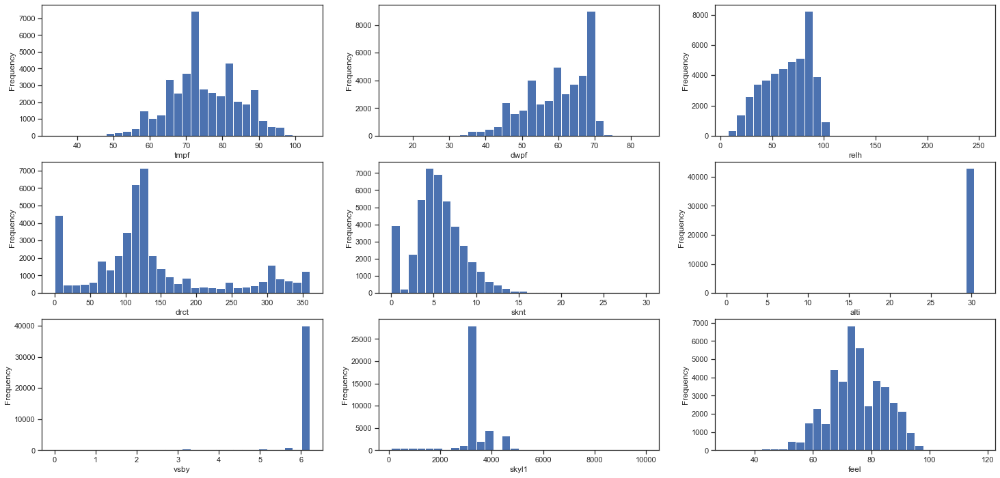

In [8]:
contColNames = list(df.select_dtypes(include='number').columns) #-> seleciona apenas colunas numéricas
ncols = 3 #-> número de colunas que armazenarão os plots na figura 
nrows = int(np.ceil(len(contColNames)/(1.0 * ncols))) #-> número de linhas que armazenarão os plots na figure 


fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(25,12))

counter = 0 

for i in range(nrows):
  for j in range(ncols):

    ax = axes[i][j]

    # Plotar somente quando houver dados
    if counter < len(contColNames):

      ax.hist(df.select_dtypes(include='number')[contColNames[counter]], bins=30)
      ax.set_xlabel(contColNames[counter])
      ax.set_ylabel('Frequency')

    else:
      ax.set_axis_off()

    counter += 1

plt.show()

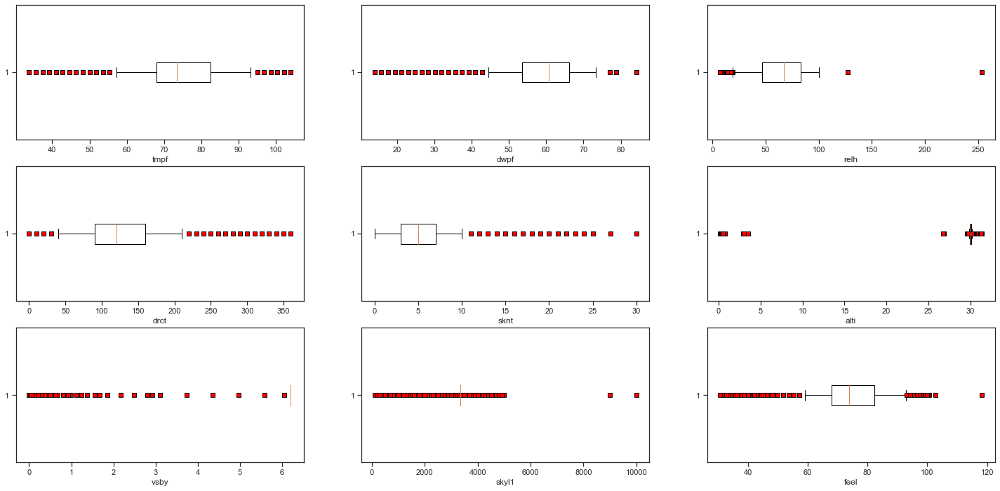

In [9]:
contColNames = list(df.select_dtypes(include='number').columns) #-> seleciona apenas colunas numéricas
ncols = 3 #-> número de colunas que armazenarão os plots na figure 
nrows = int(np.ceil(len(contColNames)/(1.0 * ncols))) #-> número de linhas que armazenarão os plots na figure 


fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(25,12))

counter = 0 

for i in range(nrows):
  for j in range(ncols):

    ax = axes[i][j]

    # Plotar somente quando houver dados
    if counter < len(contColNames):
      red_square = dict(markerfacecolor='red', marker='s')
      ax.boxplot(df.select_dtypes(include='number')[contColNames[counter]], flierprops=red_square, vert=False, whis=0.75)
      ax.set_xlabel(contColNames[counter])

    else:
      ax.set_axis_off()

    counter += 1
plt.show()

### (iii) Removing Outliers: Interquartile Range (IQR) Analysis
***Obs: for numerical features only***

As we could see previously, there are some data distributions that are not coherent. There are some visible gaps and expressive outliers in our mass - for this reason we are going to treat these data via an IQR approach.

* **dwpf: Dew Point Temperature in Fahrenheit**

In [8]:
Q1 = df['dwpf'].quantile(0.25)
Q3 = df['dwpf'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.dwpf.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    43208.000000
mean        59.635863
std          8.615351
min         14.000000
1%          37.400000
10%         46.400000
25%         53.600000
50%         60.800000
75%         66.200000
90%         69.800000
99%         71.600000
99.9%       73.400000
max         84.200000
Name: dwpf, dtype: float64 


Q1 = 53.6
Q3 = 66.2
IQR = 12.6
Normal Range: (34.7 ~ 85.1)


/tmp/ipykernel_6974/2543818226.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(pd.DataFrame(new_values))


<AxesSubplot: ylabel='Density'>

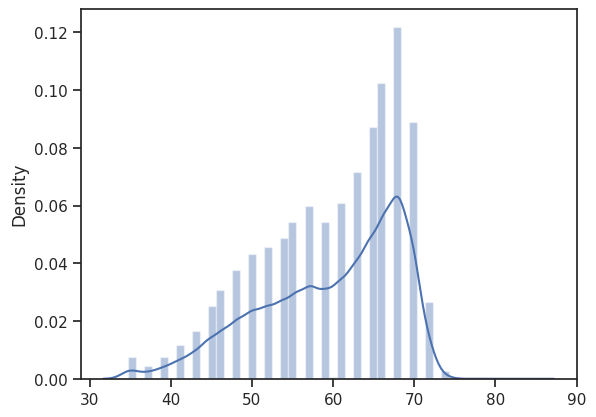

In [9]:
new_values = []
for val in df.dwpf.values:
  if val < lower_bound:
    new_values.append(lower_bound)
  elif val > upper_bound:
    new_values.append(upper_bound)
  else:
    new_values.append(val)

sns.distplot(pd.DataFrame(new_values))

In [10]:
df.dwpf = new_values
df.dwpf.describe()

count    43208.000000
mean        59.655651
std          8.547863
min         34.700000
25%         53.600000
50%         60.800000
75%         66.200000
max         84.200000
Name: dwpf, dtype: float64

* **relh: Relative Humidity in %***

In [11]:
Q1 = df['relh'].quantile(0.25)
Q3 = df['relh'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.relh.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    43208.000000
mean        64.179564
std         22.254035
min          7.160000
1%          16.150000
10%         31.900000
25%         46.410000
50%         67.225000
75%         83.090000
90%         93.830000
99%        100.000000
99.9%      100.000000
max        253.630000
Name: relh, dtype: float64 


Q1 = 46.41
Q3 = 83.09
IQR = 36.68
Normal Range: (-8.61 ~ 138.11)


/tmp/ipykernel_6974/3553003928.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(pd.DataFrame(new_values))


<AxesSubplot: ylabel='Density'>

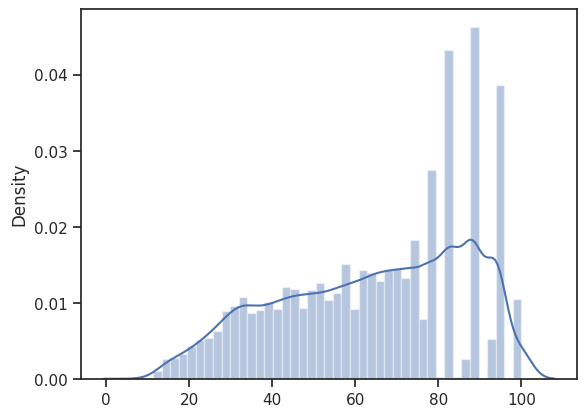

In [12]:
new_values = []
for val in df.relh.values:
  if val < 0:
    new_values.append(0)
  elif val > 100:
    new_values.append(100)
  else:
    new_values.append(val)
  
sns.distplot(pd.DataFrame(new_values))

In [13]:
df.relh = new_values
df.relh.describe()

count    43208.000000
mean        64.175374
std         22.234618
min          7.160000
25%         46.410000
50%         67.225000
75%         83.090000
max        100.000000
Name: relh, dtype: float64

* **alti:**

In [14]:
Q1 = df['alti'].quantile(0.25)
Q3 = df['alti'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.alti.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    43208.000000
mean        29.907619
std          1.589358
min          0.180000
1%          29.740000
10%         29.850000
25%         29.910000
50%         29.970000
75%         30.060000
90%         30.150000
99%         30.270000
99.9%       30.360000
max         31.360000
Name: alti, dtype: float64 


Q1 = 29.91
Q3 = 30.06
IQR = 0.15
Normal Range: (29.685 ~ 30.285)


/tmp/ipykernel_6974/3099295665.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(pd.DataFrame(new_values))


<AxesSubplot: ylabel='Density'>

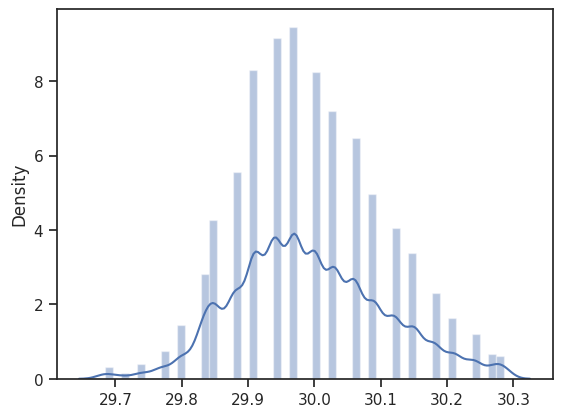

In [15]:
new_values = []
for val in df.alti.values:
  if val < lower_bound:
    new_values.append(lower_bound)
  elif val > upper_bound:
    new_values.append(upper_bound)
  else:
    new_values.append(val)

sns.distplot(pd.DataFrame(new_values))

In [16]:
df.alti = new_values
df.alti.describe()

count    43208.000000
mean        29.992416
std          0.112187
min         29.685000
25%         29.910000
50%         29.970000
75%         30.060000
max         30.285000
Name: alti, dtype: float64

* **skyl1: Sky Level 1 Altitude in feet**

In [17]:
Q1 = df['skyl1'].quantile(0.25)
Q3 = df['skyl1'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.skyl1.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    43208.000000
mean      3334.529412
std        760.831296
min        100.000000
1%         400.000000
10%       3000.000000
25%       3334.529412
50%       3334.529412
75%       3334.529412
90%       4000.000000
99%       4800.000000
99.9%     4900.000000
max      10000.000000
Name: skyl1, dtype: float64 


Q1 = 3334.529
Q3 = 3334.529
IQR = 0.0
Normal Range: (3334.529 ~ 3334.529)


/tmp/ipykernel_6974/2691586391.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(pd.DataFrame(new_values))


<AxesSubplot: ylabel='Density'>

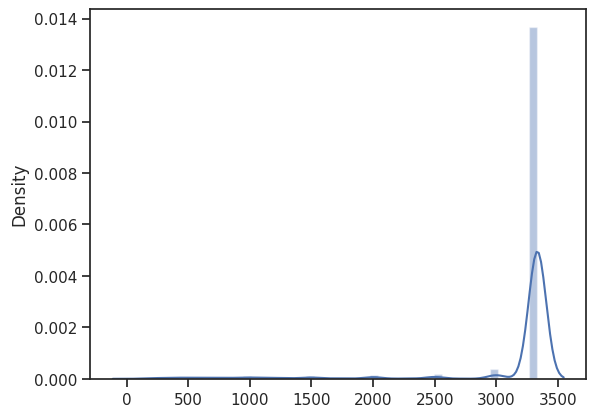

In [18]:
new_values = []
for val in df.skyl1.values:
  if val > upper_bound:
    new_values.append(upper_bound)
  else:
    new_values.append(val)
  
sns.distplot(pd.DataFrame(new_values))

In [19]:
df.skyl1 = new_values
df.skyl1.describe()

count    43208.000000
mean      3150.420102
std        602.164177
min        100.000000
25%       3334.529412
50%       3334.529412
75%       3334.529412
max       3334.529412
Name: skyl1, dtype: float64

### (iv) Feature Engineering

**Flight category definitions:** https://www.aviationweather.gov/taf/help?page=plot

In [20]:
# Remembering our dataset
df.head()

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar
0,2017-01-01 00:00:00,75.2,69.8,83.32,60.0,5.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010000Z 06005KT 9999 VCTS FEW035 FEW040CB...
1,2017-01-01 01:00:00,75.2,69.8,83.32,70.0,4.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010100Z 07004KT CAVOK 24/21 Q1016
2,2017-01-01 02:00:00,75.2,69.8,83.32,110.0,2.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010200Z 11002KT CAVOK 24/21 Q1016
3,2017-01-01 03:00:00,75.2,69.8,83.32,80.0,3.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010300Z 08003KT CAVOK 24/21 Q1015
4,2017-01-01 04:00:00,73.4,69.8,88.51,140.0,3.0,29.97,6.21,FEW,3334.529412,74.60,SBRP 010400Z 14003KT CAVOK 23/21 Q1015


* **Creating new features**

In [21]:
# 1- Time Series Decomposition:
df['year'] = df.valid.dt.year.values
df['month'] = df.valid.dt.month.values
df['dayofweek_flag'] = df.valid.dt.day_of_week.values #-> from 0 (sundays) to 7 (saturdays) 
df['day'] = df.valid.dt.day.values
df['hour'] = df.valid.dt.hour
df['min'] = df.valid.dt.minute

season_flag = []
for m in df.month:
  if m in (12,1,2):
    season_flag.append('summer')
  elif m in (3,4,5):
    season_flag.append('autumn')
  elif m in (6,7,8):
    season_flag.append('winter')
  else:
    season_flag.append('spring')
df['season_flag'] = season_flag


# 2- Flight Rules Code:
fr_code =[]
for v, slv in zip(df.vsby.values, df.skyl1.values):
  if (v > 5.) and (slv > 3e+03): # VFR: visibility > 5 miles and ceiling > 3000ft
    fr_code.append('VFR')
  elif (3. < v <= 5.) or (1e+03 < slv <= 3e+03): # MVFR: visibility between 3 and 5 miles and/or ceiling between 1000ft and 3000ft
    fr_code.append('MVFR')
  elif (1. < v <= 3.) or (5e+02 < slv <= 1e+03): # IFR: visibility between 1 and 3 miles and/or ceiling between 1000ft and 3000ft
    fr_code.append('IFR')
  elif (v <= 1.) or (slv <= 5e+02): # LIFR: visibility less than 1 mile and/or ceiling below 500ft
    fr_code.append('LIFR')
df['fr_code'] = fr_code

# Changimg DTypes
df = df.astype({
    'year':'int32',
    'month':'int32',
    'dayofweek_flag':'int32',
    'day':'int32',
    'season_flag':'category',
    'fr_code':'category'
})


df # checking for updates

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
0,2017-01-01 00:00:00,75.2,69.8,83.32,60.0,5.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010000Z 06005KT 9999 VCTS FEW035 FEW040CB...,2017,1,6,1,0,0,summer,VFR
1,2017-01-01 01:00:00,75.2,69.8,83.32,70.0,4.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010100Z 07004KT CAVOK 24/21 Q1016,2017,1,6,1,1,0,summer,VFR
2,2017-01-01 02:00:00,75.2,69.8,83.32,110.0,2.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010200Z 11002KT CAVOK 24/21 Q1016,2017,1,6,1,2,0,summer,VFR
3,2017-01-01 03:00:00,75.2,69.8,83.32,80.0,3.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010300Z 08003KT CAVOK 24/21 Q1015,2017,1,6,1,3,0,summer,VFR
4,2017-01-01 04:00:00,73.4,69.8,88.51,140.0,3.0,29.97,6.21,FEW,3334.529412,74.60,SBRP 010400Z 14003KT CAVOK 23/21 Q1015,2017,1,6,1,4,0,summer,VFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43203,2021-12-30 19:00:00,69.8,68.0,94.01,130.0,6.0,29.83,4.35,SCT,1000.000000,69.80,SBRP 301900Z 13006KT 7000 SCT010 BKN040 OVC070...,2021,12,3,30,19,0,summer,MVFR
43204,2021-12-30 20:00:00,71.6,68.0,88.43,120.0,5.0,29.80,6.21,FEW,1000.000000,71.60,SBRP 302000Z 12005KT 9999 FEW010 SCT045 OVC070...,2021,12,3,30,20,0,summer,IFR
43205,2021-12-30 21:00:00,71.6,68.0,88.43,130.0,7.0,29.80,6.21,FEW,3334.529412,71.60,SBRP 302100Z 13007KT CAVOK 22/20 Q1009,2021,12,3,30,21,0,summer,VFR
43206,2021-12-30 22:00:00,71.6,68.0,88.43,90.0,3.0,29.80,6.21,FEW,3334.529412,71.60,SBRP 302200Z 09003KT 070V130 CAVOK 22/20 Q1009,2021,12,3,30,22,0,summer,VFR


### (v) Correlation Matrix (Pearson's) and KDE Plot

<AxesSubplot:>

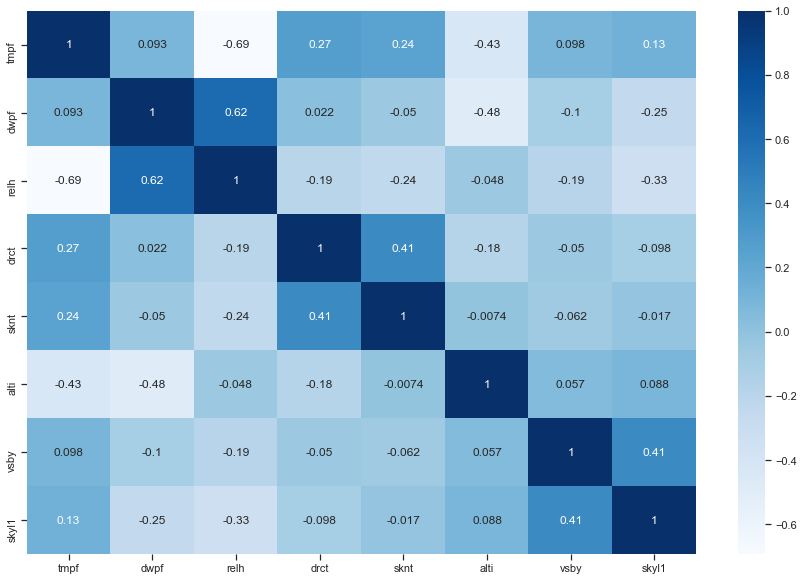

In [24]:
plt.figure(figsize=(15,10))
sns.heatmap(df[['tmpf', 'dwpf', 'relh', 'drct',
                               'sknt','alti','vsby','skyl1']].corr(), annot=True, cmap='Blues')

<AxesSubplot:title={'center':"Relation 'Relative Humidity [%]' Vs. 'Air Temperature [°F]' Coloured by Their Density\n"}, xlabel='tmpf', ylabel='relh'>

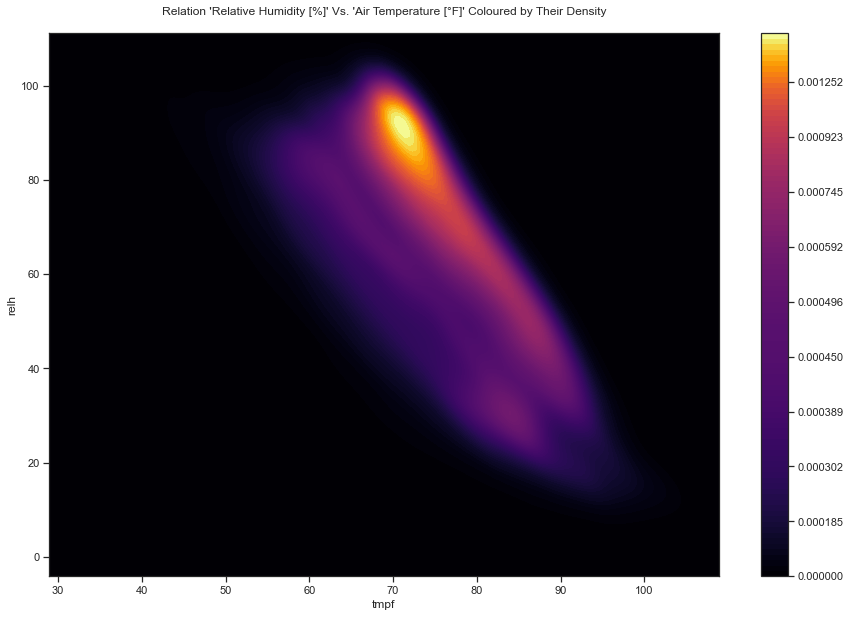

In [90]:
fig, axs = plt.subplots(figsize=(15,10))
plt.title("Relation 'Relative Humidity [%]' Vs. 'Air Temperature [°F]' Coloured by Their Density\n")
sns.kdeplot(
    data=df, x="tmpf", y="relh",
    fill=True, thresh=0, levels=100, cmap="inferno", cbar = True)

#https://seaborn.pydata.org/generated/seaborn.kdeplot.html

### (vi) Pairplot colored by Flight Rule Code

<ipython-input-91-cb43820a4ab6>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reduced_features['Flight Condition'] = cod


<Figure size 2160x1800 with 0 Axes>

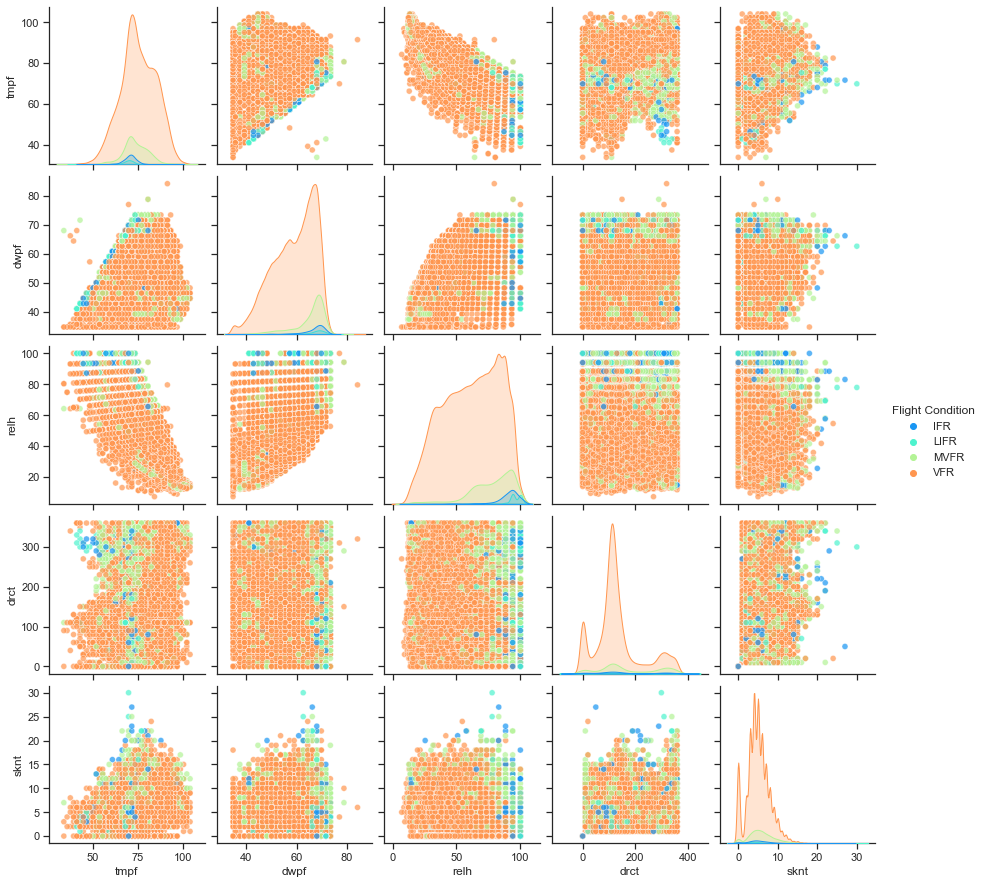

In [91]:
reduced_features = df[['tmpf','dwpf','relh','drct','sknt']]
cod = df.fr_code.values
reduced_features['Flight Condition'] = cod


# Make the pair plot with a some aesthetic changes
plt.figure(figsize=(30,25))
sns.pairplot(reduced_features, hue = 'Flight Condition', diag_kind = 'kde', palette='rainbow', plot_kws=dict(alpha = 0.7),
                   diag_kws=dict(shade=True))

### (vii) Quantitative Analysis

* **Sky Level 1 Coverage**

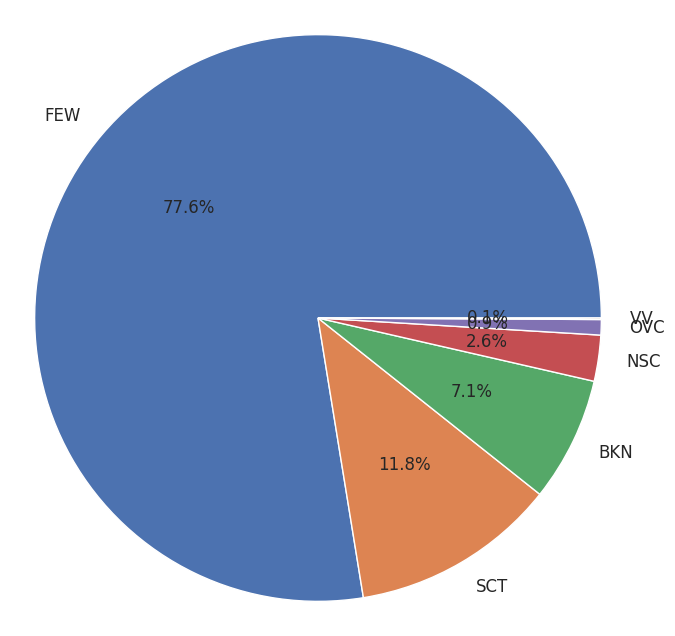

In [22]:
plt.figure(figsize=(10,8))
plt.pie(df.skyc1.value_counts(), labels = list(df.skyc1.value_counts().index), autopct='%1.1f%%', radius = 1.15, textprops = {"fontsize" : 12}) 
plt.show()

* **Flight Rules Code**

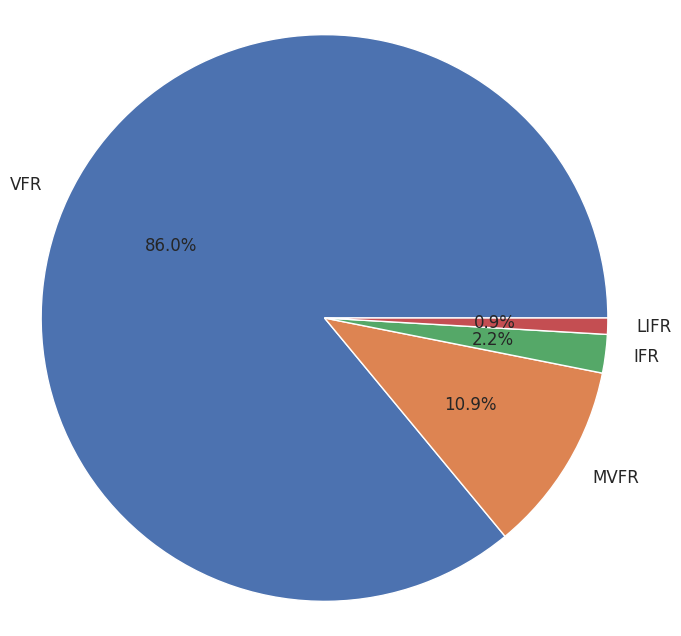

In [23]:
plt.figure(figsize=(10,8))
plt.pie(df.fr_code.value_counts(), labels = list(df.fr_code.value_counts().index), autopct='%1.1f%%', radius = 1.15, textprops = {"fontsize" : 12}) 
plt.show()

### (viii) Aggregated Analysis

* **by Year**

In [94]:
df_agg_year = df[['year','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='year').agg(['min','mean','max'])
df_agg_year

tmpf                    dwpf                    relh                    \
       min       mean    max   min       mean   max    min       mean    max   
year                                                                           
2017  44.6  74.333919  100.4  34.7  59.790919  78.8   8.87  65.421555  100.0   
2018  33.8  74.323625  100.4  34.7  60.472199  84.2  12.14  66.126265  100.0   
2019  41.0  75.144463  100.4  34.7  60.877766  73.4  12.25  65.691370  100.0   
2020  42.8  75.479428  104.0  34.7  59.078876  78.8  11.16  62.003154  100.0   
2021  33.8  74.375710  102.2  34.7  58.064783  73.4   7.16  61.597078  100.0   

     drct  ...  sknt    alti                     vsby                  skyl1  \
      min  ...   max     min       mean     max   min      mean   max    min   
year       ...                                                                 
2017  0.0  ...  25.0  29.685  30.003181  30.285  0.06  6.059706  6.21  100.0   
2018  0.0  ...  27.0  29.685  29.991754  30.285  0.06  6.062686  6.21  100.0   
2019  0.0  ...  24.0  29.685  29.999861  30.285  0.25  6.069414  6.21  100.0   
2020  0.0  ...  22.0  29.685  29.987154  30.285  0.00  6.059041  6.21  100.0   
2021  0.0  ...  30.0  29.685  29.980130  30.285  0.03  5.990376  6.21  100.0   

                                
             mean          max  
year                            
2017  3163.245482  3334.529412  
2018  3138.302289  3334.529412  
2019  3150.361048  3334.529412  
2020  3145.595400  3334.529412  
2021  3154.256885  3334.529412  

[5 rows x 24 columns]

([<matplotlib.axis.XTick at 0x1bd1d9a5d60>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

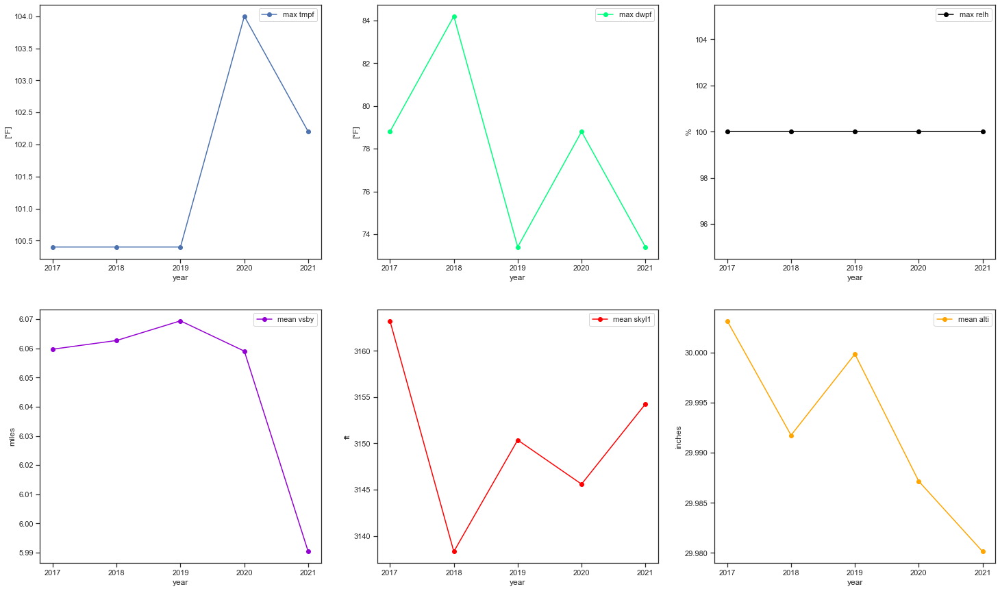

In [95]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_year.index.values, df_agg_year.tmpf['max'],'-o',color='b')
plt.xlabel('year')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_year.index.values, df_agg_year.dwpf['max'],'-o',color='springgreen')
plt.xlabel('year')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_year.index.values, df_agg_year.relh['max'],'-o',color='black')
plt.xlabel('year')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_year.index.values, df_agg_year.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('year')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_year.index.values, df_agg_year.skyl1['mean'],'-o',color='red')
plt.xlabel('year')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_year.index.values, df_agg_year.alti['mean'],'-o',color='orange')
plt.xlabel('year')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

* **by Month**

In [96]:
df_agg_month = df[['month','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='month').agg(['min','mean','max'])
df_agg_month

tmpf                    dwpf                    relh                    \
        min       mean    max   min       mean   max    min       mean    max   
month                                                                           
1      64.4  77.867078   96.8  51.8  67.454585  77.0  24.89  73.378888  100.0   
2      39.2  77.178699   98.6  35.6  67.131570  78.8  24.37  73.829791  100.0   
3      59.0  77.282382   96.8  48.2  65.956391  73.4  25.79  71.179823  100.0   
4      41.0  74.244057   93.2  35.6  61.466882  78.8  22.02  67.914354  100.0   
5      41.0  70.213130   91.4  34.7  57.281901  71.6   7.16  67.527699  100.0   
6      37.4  69.553036   89.6  34.7  55.066250  68.0  16.86  64.054324  100.0   
7      33.8  67.586679   89.6  34.7  48.177639  66.2  10.78  54.345804  100.0   
8      42.8  71.844042   96.8  34.7  50.380522  64.4  11.16  52.187725  100.0   
9      50.0  78.052830  102.2  34.7  52.058358  69.8   8.87  46.451667  100.0   
10     42.8  78.170406  104.0  34.7  61.266348  71.6  11.67  61.354164  100.0   
11     55.4  76.988707   98.6  34.7  63.123766  73.4  14.44  66.380097  100.0   
12     33.8  77.306081   96.8  39.2  66.086246  84.2  19.64  71.397806  100.0   

      drct  ...  sknt    alti                     vsby                  skyl1  \
       min  ...   max     min       mean     max   min      mean   max    min   
month       ...                                                                 
1      0.0  ...  20.0  29.685  29.934626  30.120  0.12  6.029522  6.21  100.0   
2      0.0  ...  27.0  29.685  29.921131  30.285  0.25  6.049587  6.21  100.0   
3      0.0  ...  22.0  29.685  29.949739  30.150  0.12  6.109524  6.21  100.0   
4      0.0  ...  18.0  29.685  30.001719  30.240  0.00  6.097682  6.21  100.0   
5      0.0  ...  20.0  29.685  30.047148  30.270  0.25  6.118719  6.21  200.0   
6      0.0  ...  21.0  29.685  30.104226  30.285  0.03  6.124416  6.21  100.0   
7      0.0  ...  19.0  29.830  30.132755  30.285  0.06  6.129491  6.21  200.0   
8      0.0  ...  20.0  29.685  30.086205  30.285  1.24  6.044438  6.21  300.0   
9      0.0  ...  30.0  29.685  30.000607  30.285  0.06  5.835810  6.21  200.0   
10     0.0  ...  25.0  29.685  29.931814  30.285  0.12  5.983970  6.21  100.0   
11     0.0  ...  22.0  29.685  29.903797  30.120  0.37  6.018256  6.21  100.0   
12     0.0  ...  22.0  29.685  29.904206  30.285  0.31  6.037789  6.21  200.0   

                                 
              mean          max  
month                            
1      3015.692736  3334.529412  
2      2995.427788  3334.529412  
3      3134.068899  3334.529412  
4      3190.585705  3334.529412  
5      3225.974052  3334.529412  
6      3246.253186  3334.529412  
7      3272.535697  3334.529412  
8      3260.909521  3334.529412  
9      3265.582150  3334.529412  
10     3132.936813  3334.529412  
11     3049.949826  3334.529412  
12     3018.735833  3334.529412  

[12 rows x 24 columns]

([<matplotlib.axis.XTick at 0x1bd1df66970>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

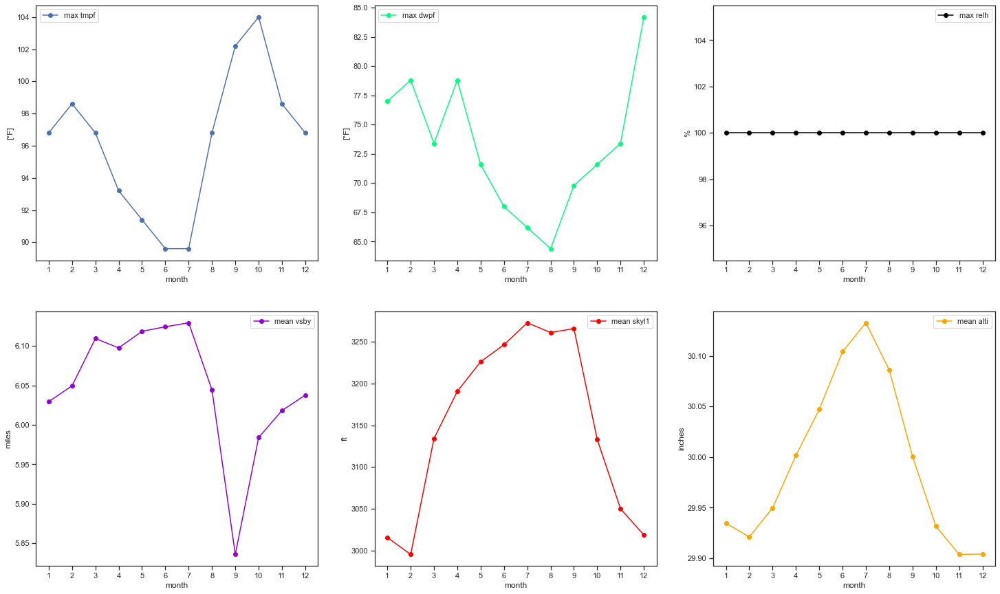

In [97]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_month.index.values, df_agg_month.tmpf['max'],'-o',color='b')
plt.xlabel('month')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_month.index.values, df_agg_month.dwpf['max'],'-o',color='springgreen')
plt.xlabel('month')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_month.index.values, df_agg_month.relh['max'],'-o',color='black')
plt.xlabel('month')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_month.index.values, df_agg_month.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('month')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_month.index.values, df_agg_month.skyl1['mean'],'-o',color='red')
plt.xlabel('month')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_month.index.values, df_agg_month.alti['mean'],'-o',color='orange')
plt.xlabel('month')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

* **by Day of the Week**

In [98]:
df_agg_dayofweek = df[['dayofweek_flag','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='dayofweek_flag').agg(['min','mean','max'])
df_agg_dayofweek

tmpf                    dwpf                    relh  \
                 min       mean    max   min       mean   max    min   
dayofweek_flag                                                         
0               41.0  74.629783  104.0  34.7  59.492122  84.2  11.74   
1               33.8  74.828465  104.0  34.7  59.701878  78.8   7.16   
2               37.4  74.950145  104.0  34.7  59.639558  78.8  11.16   
3               37.4  74.698499  102.2  34.7  59.742394  73.4  12.25   
4               37.4  74.652538  102.2  34.7  59.716841  73.4   8.87   
5               42.8  74.738382  104.0  34.7  59.685787  73.4   9.38   
6               33.8  74.573089  102.2  34.7  59.611342  73.4  12.05   

                                 drct  ...  sknt    alti                     \
                     mean    max  min  ...   max     min       mean     max   
dayofweek_flag                         ...                                    
0               64.009553  100.0  0.0  ...  18.0  29.685  29.993390  30.285   
1               63.917573  100.0  0.0  ...  21.0  29.685  29.991398  30.285   
2               63.757045  100.0  0.0  ...  22.0  29.685  29.991721  30.285   
3               64.405760  100.0  0.0  ...  23.0  29.685  29.993158  30.285   
4               64.479522  100.0  0.0  ...  27.0  29.685  29.992445  30.285   
5               64.229740  100.0  0.0  ...  20.0  29.685  29.992499  30.285   
6               64.425880  100.0  0.0  ...  30.0  29.685  29.992298  30.285   

                vsby                  skyl1                            
                 min      mean   max    min         mean          max  
dayofweek_flag                                                         
0               0.25  6.082303  6.21  100.0  3160.877960  3334.529412  
1               0.12  6.059098  6.21  100.0  3171.647202  3334.529412  
2               0.00  6.055298  6.21  100.0  3154.361549  3334.529412  
3               0.06  6.032405  6.21  200.0  3144.248158  3334.529412  
4               0.06  6.031350  6.21  200.0  3148.854751  3334.529412  
5               0.03  6.048892  6.21  100.0  3134.261761  3334.529412  
6               0.12  6.026167  6.21  100.0  3138.813618  3334.529412  

[7 rows x 24 columns]

([<matplotlib.axis.XTick at 0x1bd1eb678b0>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

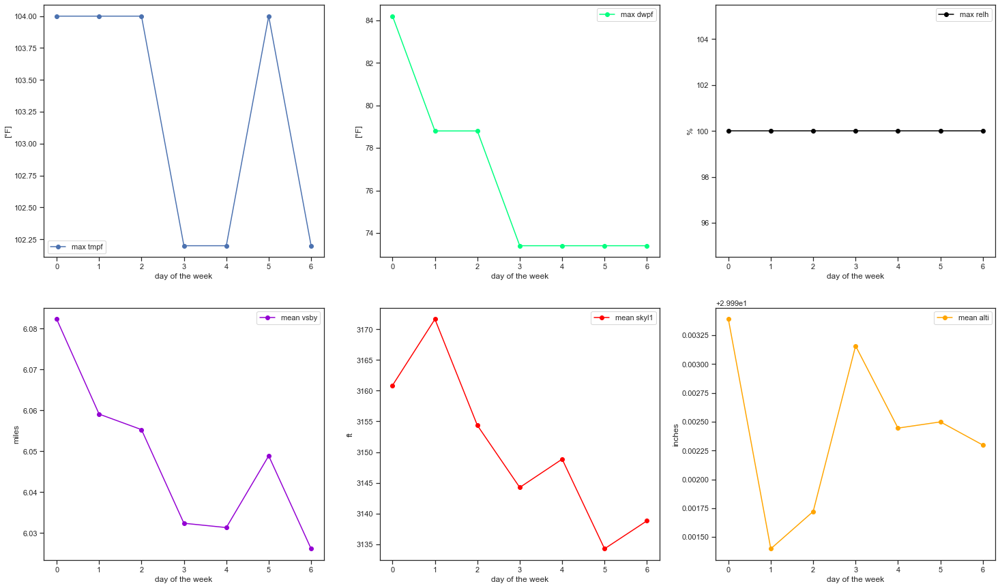

In [99]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.tmpf['max'],'-o',color='b')
plt.xlabel('day of the week')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.dwpf['max'],'-o',color='springgreen')
plt.xlabel('day of the week')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.relh['max'],'-o',color='black')
plt.xlabel('day of the week')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('day of the week')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.skyl1['mean'],'-o',color='red')
plt.xlabel('day of the week')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.alti['mean'],'-o',color='orange')
plt.xlabel('day of the week')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

* **by Season**

In [100]:
df_agg_season = df[['season_flag','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='season_flag').agg(['min','mean','max'])
df_agg_season

tmpf                    dwpf                    relh             \
              min       mean    max   min       mean   max    min       mean   
season_flag                                                                    
autumn       41.0  73.900952   96.8  34.7  61.558808  78.8   7.16  68.879740   
spring       42.8  77.742846  104.0  34.7  58.851366  73.4   8.87  58.110444   
summer       33.8  77.459256   98.6  35.6  66.882547  84.2  19.64  72.837018   
winter       33.8  69.663240   96.8  34.7  51.122688  68.0  10.78  56.703931   

                   drct  ...  sknt    alti                     vsby            \
               max  min  ...   max     min       mean     max   min      mean   
season_flag              ...                                                    
autumn       100.0  0.0  ...  22.0  29.685  29.999632  30.270  0.00  6.108770   
spring       100.0  0.0  ...  30.0  29.685  29.945203  30.285  0.06  5.946560   
summer       100.0  0.0  ...  27.0  29.685  29.919941  30.285  0.12  6.038624   
winter       100.0  0.0  ...  21.0  29.685  30.107810  30.285  0.03  6.098905   

                   skyl1                            
              max    min         mean          max  
season_flag                                         
autumn       6.21  100.0  3183.580533  3334.529412  
spring       6.21  100.0  3149.219455  3334.529412  
summer       6.21  100.0  3010.424178  3334.529412  
winter       6.21  100.0  3260.202067  3334.529412  

[4 rows x 24 columns]

([<matplotlib.axis.XTick at 0x1bd1ecdf1f0>,
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

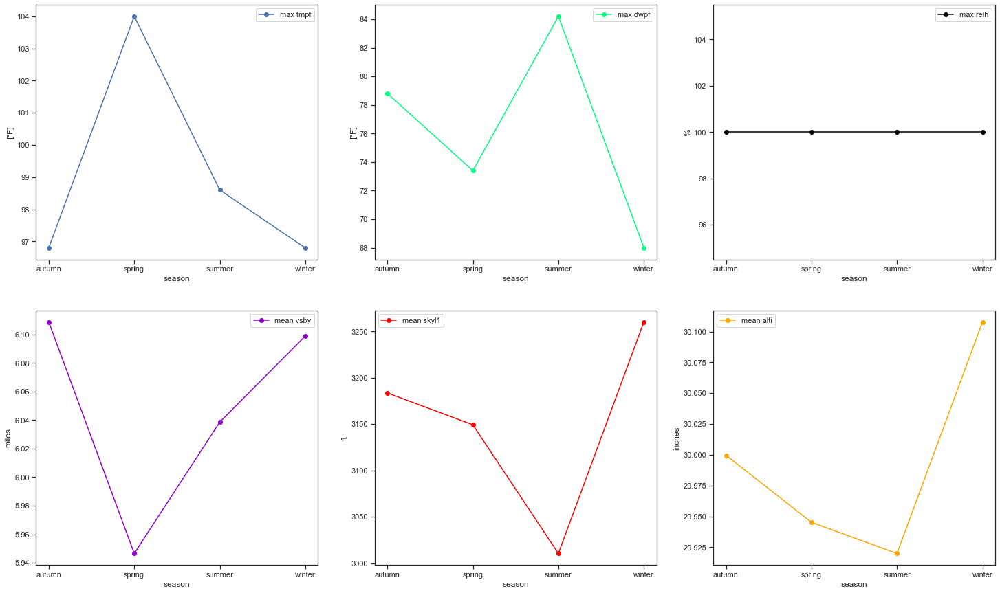

In [101]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_season.index.values, df_agg_season.tmpf['max'],'-o',color='b')
plt.xlabel('season')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_season.index.values, df_agg_season.dwpf['max'],'-o',color='springgreen')
plt.xlabel('season')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_season.index.values, df_agg_season.relh['max'],'-o',color='black')
plt.xlabel('season')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_season.index.values, df_agg_season.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('season')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_season.index.values, df_agg_season.skyl1['mean'],'-o',color='red')
plt.xlabel('season')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_season.index.values, df_agg_season.alti['mean'],'-o',color='orange')
plt.xlabel('season')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

### (ix) Time Series

In [25]:
fig = px.area(df[['fr_code','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']], facet_col="fr_code",facet_col_wrap=2)
fig.show()

In [26]:
fig = px.line(df, x='valid', y='tmpf', title='Air Temperature [°F]')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [27]:
fig = px.line(df, x='valid', y='sknt', title='Wind Speed [knots]')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [28]:
fig = px.line(df, x='valid', y='alti', title='Pressure altimeter [inches]')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

## 3- Machine Learning Algorythm

### (i) Creating a new DataFrame

In [24]:
# Creating a copy from the previous DF
df_model = df.copy()
df_model.head()

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
0,2017-01-01 00:00:00,75.2,69.8,83.32,60.0,5.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010000Z 06005KT 9999 VCTS FEW035 FEW040CB...,2017,1,6,1,0,0,summer,VFR
1,2017-01-01 01:00:00,75.2,69.8,83.32,70.0,4.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010100Z 07004KT CAVOK 24/21 Q1016,2017,1,6,1,1,0,summer,VFR
2,2017-01-01 02:00:00,75.2,69.8,83.32,110.0,2.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010200Z 11002KT CAVOK 24/21 Q1016,2017,1,6,1,2,0,summer,VFR
3,2017-01-01 03:00:00,75.2,69.8,83.32,80.0,3.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010300Z 08003KT CAVOK 24/21 Q1015,2017,1,6,1,3,0,summer,VFR
4,2017-01-01 04:00:00,73.4,69.8,88.51,140.0,3.0,29.97,6.21,FEW,3334.529412,74.60,SBRP 010400Z 14003KT CAVOK 23/21 Q1015,2017,1,6,1,4,0,summer,VFR


* **First we need to filter the data that was logged hourly**

In [31]:
df_model.loc[df['min']!=0] # Checking the values that don't match with our 'hourly' logged data

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
184,2017-01-08 17:16:00,93.2,64.4,38.73,310.0,7.0,29.85,6.21,BKN,3334.529412,95.20,SBRP 081716Z 31007KT 9999 -TSRA BKN040 FEW045C...,2017,1,6,8,17,16,summer,VFR
240,2017-01-11 05:30:00,71.6,69.8,94.06,330.0,8.0,29.91,4.97,SCT,500.000000,72.88,SBRP 110530Z 33008KT 8000 -RA SCT005 OVC025 22...,2017,1,2,11,5,30,summer,MVFR
248,2017-01-11 12:20:00,71.6,71.6,100.00,300.0,6.0,29.94,4.35,BKN,500.000000,73.16,SBRP 111220Z 30006KT 7000 -RA BKN005 OVC080 22...,2017,1,2,11,12,20,summer,MVFR
279,2017-01-12 18:15:00,77.0,66.2,69.33,40.0,15.0,29.88,6.21,FEW,3334.529412,77.00,SBRP 121815Z 04015G30KT 9999 TS VCSH FEW035 FE...,2017,1,3,12,18,15,summer,VFR
280,2017-01-12 19:35:00,69.8,69.8,100.00,210.0,4.0,29.88,3.73,FEW,900.000000,69.80,SBRP 121935Z 21004KT 6000 -TSRA FEW009 BKN035 ...,2017,1,3,12,19,35,summer,MVFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43176,2021-12-29 20:40:00,69.8,68.0,94.01,70.0,4.0,29.88,6.21,SCT,3000.000000,69.80,SBRP 292040Z 07004KT 9999 TS VCSH SCT030 FEW03...,2021,12,2,29,20,40,summer,MVFR
43191,2021-12-30 10:44:00,69.8,68.0,94.01,0.0,0.0,29.91,1.86,SCT,500.000000,69.80,SBRP 301044Z 00000KT 3000 -RA BR SCT005 BKN015...,2021,12,3,30,10,44,summer,IFR
43196,2021-12-30 14:19:00,71.6,69.8,94.06,60.0,7.0,29.91,0.62,FEW,300.000000,71.60,SBRP 301419Z 06007KT 1000 +RA BR FEW003 BKN015...,2021,12,3,30,14,19,summer,LIFR
43197,2021-12-30 14:40:00,69.8,68.0,94.01,60.0,5.0,29.91,1.86,FEW,300.000000,69.80,SBRP 301440Z 06005KT 3000 -RA BR FEW003 BKN015...,2021,12,3,30,14,40,summer,IFR


In [25]:
# Counting the frequency registered by each minute log
df_model['min'].value_counts()

0     43008
10       18
25       18
30       16
40       16
35       15
20       10
45        9
15        8
34        6
31        5
42        5
11        4
26        4
9         4
28        4
23        4
32        4
46        4
16        4
38        3
27        3
22        3
19        3
5         3
37        3
14        2
29        2
41        2
24        2
12        2
43        2
3         2
49        2
36        1
52        1
21        1
17        1
39        1
48        1
51        1
44        1
Name: min, dtype: int64

* **Hourly Logged DataFrame**

In [26]:
df_model = df_model.loc[df['min']==0] # values registered from hour to hour
df_model

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
0,2017-01-01 00:00:00,75.2,69.8,83.32,60.0,5.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010000Z 06005KT 9999 VCTS FEW035 FEW040CB...,2017,1,6,1,0,0,summer,VFR
1,2017-01-01 01:00:00,75.2,69.8,83.32,70.0,4.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010100Z 07004KT CAVOK 24/21 Q1016,2017,1,6,1,1,0,summer,VFR
2,2017-01-01 02:00:00,75.2,69.8,83.32,110.0,2.0,30.00,6.21,FEW,3334.529412,76.34,SBRP 010200Z 11002KT CAVOK 24/21 Q1016,2017,1,6,1,2,0,summer,VFR
3,2017-01-01 03:00:00,75.2,69.8,83.32,80.0,3.0,29.97,6.21,FEW,3334.529412,76.34,SBRP 010300Z 08003KT CAVOK 24/21 Q1015,2017,1,6,1,3,0,summer,VFR
4,2017-01-01 04:00:00,73.4,69.8,88.51,140.0,3.0,29.97,6.21,FEW,3334.529412,74.60,SBRP 010400Z 14003KT CAVOK 23/21 Q1015,2017,1,6,1,4,0,summer,VFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43203,2021-12-30 19:00:00,69.8,68.0,94.01,130.0,6.0,29.83,4.35,SCT,1000.000000,69.80,SBRP 301900Z 13006KT 7000 SCT010 BKN040 OVC070...,2021,12,3,30,19,0,summer,MVFR
43204,2021-12-30 20:00:00,71.6,68.0,88.43,120.0,5.0,29.80,6.21,FEW,1000.000000,71.60,SBRP 302000Z 12005KT 9999 FEW010 SCT045 OVC070...,2021,12,3,30,20,0,summer,IFR
43205,2021-12-30 21:00:00,71.6,68.0,88.43,130.0,7.0,29.80,6.21,FEW,3334.529412,71.60,SBRP 302100Z 13007KT CAVOK 22/20 Q1009,2021,12,3,30,21,0,summer,VFR
43206,2021-12-30 22:00:00,71.6,68.0,88.43,90.0,3.0,29.80,6.21,FEW,3334.529412,71.60,SBRP 302200Z 09003KT 070V130 CAVOK 22/20 Q1009,2021,12,3,30,22,0,summer,VFR


In [27]:
# Confirming the changes
df_model['min'].value_counts()

0    43008
Name: min, dtype: int64

* **Selecting variables of interest (summarized data)**

In [28]:
df_model_s = df_model.drop(['valid','vsby','skyl1','feel',
                            'metar','year','day','hour','min'],axis=1)
df_model_s

,tmpf,dwpf,relh,drct,sknt,alti,skyc1,month,dayofweek_flag,season_flag,fr_code
0,75.2,69.8,83.32,60.0,5.0,29.97,FEW,1,6,summer,VFR
1,75.2,69.8,83.32,70.0,4.0,30.00,FEW,1,6,summer,VFR
2,75.2,69.8,83.32,110.0,2.0,30.00,FEW,1,6,summer,VFR
3,75.2,69.8,83.32,80.0,3.0,29.97,FEW,1,6,summer,VFR
4,73.4,69.8,88.51,140.0,3.0,29.97,FEW,1,6,summer,VFR
...,...,...,...,...,...,...,...,...,...,...,...
43203,69.8,68.0,94.01,130.0,6.0,29.83,SCT,12,3,summer,MVFR
43204,71.6,68.0,88.43,120.0,5.0,29.80,FEW,12,3,summer,IFR
43205,71.6,68.0,88.43,130.0,7.0,29.80,FEW,12,3,summer,VFR
43206,71.6,68.0,88.43,90.0,3.0,29.80,FEW,12,3,summer,VFR


### (ii) One-Hot encoding

* **Changing month and day_of_week values**

In [29]:
new_val_month = []
new_val_dow = []

for m,d in zip(df_model_s.month.values, df_model_s.dayofweek_flag.values):
  
  # for months
  if m==1:
    new_val_month.append('Jan')
  elif m==2:
    new_val_month.append('Feb')
  elif m==3:
    new_val_month.append('Mar')
  elif m==4:
    new_val_month.append('Apr')
  elif m==5:
    new_val_month.append('May')
  elif m==6:
    new_val_month.append('Jun')
  elif m==7:
    new_val_month.append('Jul')
  elif m==8:
    new_val_month.append('Aug')
  elif m==9:
    new_val_month.append('Sep')
  elif m==10:
    new_val_month.append('Oct')
  elif m==11:
    new_val_month.append('Nov')
  else:
    new_val_month.append('Dec')

  # for days of the week:
  if d==0:
    new_val_dow.append('Sun')
  elif d==1:
    new_val_dow.append('Mon')
  elif d==2:
    new_val_dow.append('Tues')
  elif d==3:
    new_val_dow.append('Wed')
  elif d==4:
    new_val_dow.append('Thurs')
  elif d==5:
    new_val_dow.append('Fri')
  else:
    new_val_dow.append('Sat')


df_model_s['month'] = new_val_month
df_model_s['dayofweek_flag'] = new_val_dow
df_model_s.head()

,tmpf,dwpf,relh,drct,sknt,alti,skyc1,month,dayofweek_flag,season_flag,fr_code
0,75.2,69.8,83.32,60.0,5.0,29.97,FEW,Jan,Sat,summer,VFR
1,75.2,69.8,83.32,70.0,4.0,30.00,FEW,Jan,Sat,summer,VFR
2,75.2,69.8,83.32,110.0,2.0,30.00,FEW,Jan,Sat,summer,VFR
3,75.2,69.8,83.32,80.0,3.0,29.97,FEW,Jan,Sat,summer,VFR
4,73.4,69.8,88.51,140.0,3.0,29.97,FEW,Jan,Sat,summer,VFR


* **Encoding**

In [30]:
df_model_s = pd.get_dummies(df_model_s, columns=['skyc1','month','dayofweek_flag','season_flag','fr_code'])
df_model_s

,tmpf,dwpf,relh,drct,sknt,alti,skyc1_BKN,skyc1_FEW,skyc1_NSC,skyc1_OVC,...,dayofweek_flag_Tues,dayofweek_flag_Wed,season_flag_autumn,season_flag_spring,season_flag_summer,season_flag_winter,fr_code_IFR,fr_code_LIFR,fr_code_MVFR,fr_code_VFR
0,75.2,69.8,83.32,60.0,5.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
1,75.2,69.8,83.32,70.0,4.0,30.00,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
2,75.2,69.8,83.32,110.0,2.0,30.00,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
3,75.2,69.8,83.32,80.0,3.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
4,73.4,69.8,88.51,140.0,3.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43203,69.8,68.0,94.01,130.0,6.0,29.83,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0
43204,71.6,68.0,88.43,120.0,5.0,29.80,0,1,0,0,...,0,1,0,0,1,0,1,0,0,0
43205,71.6,68.0,88.43,130.0,7.0,29.80,0,1,0,0,...,0,1,0,0,1,0,0,0,0,1
43206,71.6,68.0,88.43,90.0,3.0,29.80,0,1,0,0,...,0,1,0,0,1,0,0,0,0,1


In [31]:
df_model_s.columns

Index(['tmpf', 'dwpf', 'relh', 'drct', 'sknt', 'alti', 'skyc1_BKN',
       'skyc1_FEW', 'skyc1_NSC', 'skyc1_OVC', 'skyc1_SCT', 'skyc1_VV ',
       'month_Apr', 'month_Aug', 'month_Dec', 'month_Feb', 'month_Jan',
       'month_Jul', 'month_Jun', 'month_Mar', 'month_May', 'month_Nov',
       'month_Oct', 'month_Sep', 'dayofweek_flag_Fri', 'dayofweek_flag_Mon',
       'dayofweek_flag_Sat', 'dayofweek_flag_Sun', 'dayofweek_flag_Thurs',
       'dayofweek_flag_Tues', 'dayofweek_flag_Wed', 'season_flag_autumn',
       'season_flag_spring', 'season_flag_summer', 'season_flag_winter',
       'fr_code_IFR', 'fr_code_LIFR', 'fr_code_MVFR', 'fr_code_VFR'],
      dtype='object')

### (iii) Creating X,y matrices

For this analysis, we are going to consider an 'hourly' prediction, e.g, we use the previous data to predict the next hour variables of interest. Our data will be structured as following:

- X: has all the variables, including only 'even' rows;
    - columns: **['tmpf', 'dwpf', 'relh', 'drct', 'alti', 'skyc1_BKN',
       'skyc1_FEW', 'skyc1_NSC', 'skyc1_OVC', 'skyc1_SCT', 'skyc1_VV ',
       'month_Apr', 'month_Aug', 'month_Dec', 'month_Feb', 'month_Jan',
       'month_Jul', 'month_Jun', 'month_Mar', 'month_May', 'month_Nov',
       'month_Oct', 'month_Sep', 'dayofweek_flag_Fri', 'dayofweek_flag_Mon',
       'dayofweek_flag_Sat', 'dayofweek_flag_Sun', 'dayofweek_flag_Thurs',
       'dayofweek_flag_Tues', 'dayofweek_flag_Wed', 'season_flag_autumn',
       'season_flag_spring', 'season_flag_summer', 'season_flag_winter',
       'fr_code_IFR', 'fr_code_LIFR', 'fr_code_MVFR', 'fr_code_VFR']**

- y: has the interest variables to be predicted, e.g, the float ones. Includes the 'odd' rows
    - columns: **['tmpf', 'relh', 'sknt', 'alti']**

In [32]:
# To make an hourly prediction we need to have the total number of rows as an even number:

if len(df_model_s)%2 == 1: #division by 2 results 1 for odd numbers and 0 for even numbers
  df_model_s = df_model_s.iloc[[x for x in range(0,len(df_model_s)-1)]] #discards the last row
else:
  pass

df_model_s

,tmpf,dwpf,relh,drct,sknt,alti,skyc1_BKN,skyc1_FEW,skyc1_NSC,skyc1_OVC,...,dayofweek_flag_Tues,dayofweek_flag_Wed,season_flag_autumn,season_flag_spring,season_flag_summer,season_flag_winter,fr_code_IFR,fr_code_LIFR,fr_code_MVFR,fr_code_VFR
0,75.2,69.8,83.32,60.0,5.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
1,75.2,69.8,83.32,70.0,4.0,30.00,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
2,75.2,69.8,83.32,110.0,2.0,30.00,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
3,75.2,69.8,83.32,80.0,3.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
4,73.4,69.8,88.51,140.0,3.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43203,69.8,68.0,94.01,130.0,6.0,29.83,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0
43204,71.6,68.0,88.43,120.0,5.0,29.80,0,1,0,0,...,0,1,0,0,1,0,1,0,0,0
43205,71.6,68.0,88.43,130.0,7.0,29.80,0,1,0,0,...,0,1,0,0,1,0,0,0,0,1
43206,71.6,68.0,88.43,90.0,3.0,29.80,0,1,0,0,...,0,1,0,0,1,0,0,0,0,1


* **X, y matrices:**

In [33]:
start_x, end_x = 0, len(df_model_s)-1

# iterating each number in list
x_pos = []
for num in range(start_x, end_x):
    # checking condition
    if num % 2 == 0:
        x_pos.append(num)

X = df_model_s.iloc[x_pos]
X

,tmpf,dwpf,relh,drct,sknt,alti,skyc1_BKN,skyc1_FEW,skyc1_NSC,skyc1_OVC,...,dayofweek_flag_Tues,dayofweek_flag_Wed,season_flag_autumn,season_flag_spring,season_flag_summer,season_flag_winter,fr_code_IFR,fr_code_LIFR,fr_code_MVFR,fr_code_VFR
0,75.2,69.8,83.32,60.0,5.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
2,75.2,69.8,83.32,110.0,2.0,30.00,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
4,73.4,69.8,88.51,140.0,3.0,29.97,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
6,71.6,69.8,94.06,0.0,0.0,29.94,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
8,71.6,69.8,94.06,90.0,4.0,29.94,0,1,0,0,...,0,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43195,71.6,68.0,88.43,90.0,6.0,29.91,0,1,0,0,...,0,1,0,0,1,0,1,0,0,0
43199,71.6,69.8,94.06,100.0,8.0,29.88,0,0,0,0,...,0,1,0,0,1,0,0,0,1,0
43202,71.6,68.0,88.43,80.0,6.0,29.85,0,0,0,0,...,0,1,0,0,1,0,1,0,0,0
43204,71.6,68.0,88.43,120.0,5.0,29.80,0,1,0,0,...,0,1,0,0,1,0,1,0,0,0


In [34]:
start_y, end_y = 1, len(df_model_s)

# iterating each number in list
y_pos = []
for num in range(start_y, end_y):
    # checking condition
    if num % 2 != 0:
        y_pos.append(num)

y = df_model_s[['tmpf', 'relh', 'sknt', 'alti']].iloc[y_pos]
y

,tmpf,relh,sknt,alti
1,75.2,83.32,4.0,30.00
3,75.2,83.32,3.0,29.97
5,73.4,88.51,3.0,29.94
7,71.6,94.06,4.0,29.94
9,71.6,94.06,3.0,29.97
...,...,...,...,...
43198,69.8,100.00,5.0,29.91
43201,73.4,83.21,10.0,29.85
43203,69.8,94.01,6.0,29.83
43205,71.6,88.43,7.0,29.80


### (iv) Train/test data

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 42)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(16128, 39)
(5376, 39)
(16128, 4)
(5376, 4)


### (v) Selecting the regression model

* **Manifold**

In [36]:
from sklearn.linear_model import LinearRegression, LassoLars
from sklearn import svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

In [53]:
from sklearn import metrics
from sklearn.multioutput import MultiOutputRegressor

linear_model = MultiOutputRegressor(LinearRegression())
linear_model.fit(X_train,y_train)
y_pred_linear = linear_model.predict(X_test)

R2_tmpf_linear = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_linear[:,0]))
R2_relh_linear = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_linear[:,1]))
R2_sknt_linear = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_linear[:,2]))
R2_alti_linear = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_linear[:,3]))
Avg_R2_linear = (1/4)*(R2_tmpf_linear + R2_relh_linear + R2_sknt_linear + R2_alti_linear)

print(y_pred_linear)

[[64.49356697 77.01542525  3.80258823 30.06730323]
 [65.34315916 80.58660926  1.81926525 29.87205965]
 [81.58345397 33.22235057 10.92127418 30.02749115]
 ...
 [56.9180118  73.19540787  3.30706942 30.10292268]
 [78.65127575 44.74933691  4.26395736 30.08404642]
 [67.427431   79.67299481  5.37134836 29.84778386]]


In [54]:
from sklearn import metrics
from sklearn.multioutput import MultiOutputRegressor

lars_model = MultiOutputRegressor(LassoLars())
lars_model.fit(X_train,y_train)
y_pred_lars = linear_model.predict(X_test)

R2_tmpf_lars = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_lars[:,0]))
R2_relh_lars = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_lars[:,1]))
R2_sknt_lars = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_lars[:,2]))
R2_alti_lars = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_lars[:,3]))
Avg_R2_lars = (1/4)*(R2_tmpf_lars + R2_relh_lars + R2_sknt_lars + R2_alti_lars)

print(y_pred_lars)

[[64.49356697 77.01542525  3.80258823 30.06730323]
 [65.34315916 80.58660926  1.81926525 29.87205965]
 [81.58345397 33.22235057 10.92127418 30.02749115]
 ...
 [56.9180118  73.19540787  3.30706942 30.10292268]
 [78.65127575 44.74933691  4.26395736 30.08404642]
 [67.427431   79.67299481  5.37134836 29.84778386]]


In [55]:
from sklearn import metrics
from sklearn.multioutput import MultiOutputRegressor

svm_model = MultiOutputRegressor(svm.SVR())
svm_model.fit(X_train,y_train)
y_pred_svm = svm_model.predict(X_test)

R2_tmpf_svm = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_svm[:,0]))
R2_relh_svm = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_svm[:,1]))
R2_sknt_svm = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_svm[:,2]))
R2_alti_svm = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_svm[:,3]))
Avg_R2_svm = (1/4)*(R2_tmpf_svm + R2_relh_svm + R2_sknt_svm + R2_alti_svm)

print(y_pred_svm)

[[63.98351505 78.96489479  4.01790089 30.07170096]
 [66.50496993 79.18585939  2.09499358 29.99734874]
 [84.24792031 33.8355386   8.14033962 29.95885848]
 ...
 [57.01879116 72.77645864  4.26310631 30.1569327 ]
 [78.43898825 46.40917545  3.91386388 30.02756059]
 [68.09149428 77.62821125  5.29039424 30.00775121]]


In [56]:
from sklearn import metrics
from sklearn.multioutput import MultiOutputRegressor

rf_model = MultiOutputRegressor(RandomForestRegressor())
rf_model.fit(X_train,y_train)
y_pred_rf = rf_model.predict(X_test)

R2_tmpf_rf = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_rf[:,0]))
R2_relh_rf = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_rf[:,1]))
R2_sknt_rf = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_rf[:,2]))
R2_alti_rf = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_rf[:,3]))
Avg_R2_rf = (1/4)*(R2_tmpf_rf + R2_relh_rf + R2_sknt_rf + R2_alti_rf)

print(y_pred_rf)

[[61.808      78.6955      3.13       30.0546    ]
 [66.884      78.5361      1.64333333 29.8567    ]
 [80.456      34.3118     11.72       30.0219    ]
 ...
 [55.328      76.8719      3.18       30.0762    ]
 [79.088      46.291       1.56       30.0981    ]
 [68.378      78.3792      5.8        29.8344    ]]


In [57]:
from sklearn import metrics
from sklearn.multioutput import MultiOutputRegressor

gb_model = MultiOutputRegressor(GradientBoostingRegressor())
gb_model.fit(X_train,y_train)
y_pred_gb = gb_model.predict(X_test)

R2_tmpf_gb = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_gb[:,0]))
R2_relh_gb = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_gb[:,1]))
R2_sknt_gb = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_gb[:,2]))
R2_alti_gb = abs(metrics.r2_score(np.array(y_test.tmpf),y_pred_gb[:,3]))
Avg_R2_gb = (1/4)*(R2_tmpf_gb + R2_relh_gb + R2_sknt_gb + R2_alti_gb)

print(y_pred_rf)

[[61.808      78.6955      3.13       30.0546    ]
 [66.884      78.5361      1.64333333 29.8567    ]
 [80.456      34.3118     11.72       30.0219    ]
 ...
 [55.328      76.8719      3.18       30.0762    ]
 [79.088      46.291       1.56       30.0981    ]
 [68.378      78.3792      5.8        29.8344    ]]


In [58]:
metrics = pd.DataFrame({'model':['Linear','LARS Lasso','SVM','Random Forest','Gradient Boosting'],
                        'r2_tmpf':[R2_tmpf_linear,R2_tmpf_lars,R2_tmpf_svm,R2_tmpf_rf,R2_tmpf_gb],
                        'r2_relh':[R2_relh_linear,R2_relh_lars,R2_relh_svm,R2_relh_rf,R2_relh_gb],
                        'r2_sknt':[R2_sknt_linear,R2_sknt_lars,R2_sknt_svm,R2_sknt_rf,R2_sknt_gb],
                        'r2_alti':[R2_alti_linear,R2_alti_lars,R2_alti_svm,R2_alti_rf,R2_alti_gb],
                        'Avg_r2':[Avg_R2_linear,Avg_R2_lars,Avg_R2_svm,Avg_R2_rf,Avg_R2_gb]})
metrics

,model,r2_tmpf,r2_relh,r2_sknt,r2_alti,Avg_r2
0,Linear,0.912356,8.826107,51.270046,21.206183,20.553673
1,LARS Lasso,0.912356,8.826107,51.270046,21.206183,20.553673
2,SVM,0.901640,9.013409,51.465525,21.207635,20.647052
3,Random Forest,0.914206,8.862739,51.266211,21.206219,20.562344
4,Gradient Boosting,0.919527,8.826254,51.277854,21.206124,20.557440


* **Specific**

In [74]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.model_selection import RandomizedSearchCV

model = MultiOutputRegressor(GradientBoostingRegressor(learning_rate=0.1, n_estimators=100, subsample=1.0,
                                                       criterion='friedman_mse', min_samples_split=2,
                                                       min_samples_leaf=1,
                                                       min_weight_fraction_leaf=0.0, max_depth=3,
                                                       min_impurity_decrease=0.0, init=None, random_state=42,
                                                       max_features=None,
                                                       alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False,
                                                       validation_fraction=0.1, n_iter_no_change=None, tol=0.0001,
                                                       ccp_alpha=0.0))

hyperparameters = dict(estimator__learning_rate=[0.05, 0.1, 0.2, 0.5, 0.9],
                     estimator__n_estimators=[20, 50, 100, 200, 300, 500, 700, 1000],
                     estimator__criterion=['friedman_mse', 'mse'], estimator__min_samples_split=[2, 4, 7, 10],
                     estimator__max_depth=[3, 5, 10, 15, 20, 30], estimator__min_samples_leaf=[1, 2, 3, 5, 8, 10],
                     estimator__min_impurity_decrease=[0, 0.2, 0.4, 0.6, 0.8],
                     estimator__max_leaf_nodes=[5, 10, 20, 30, 50, 100, 300])

randomized_search = RandomizedSearchCV(model, hyperparameters, random_state=42, n_iter=5, scoring=None,
                                       n_jobs=2, refit=True, cv=5, verbose=True,
                                       pre_dispatch='2*n_jobs', error_score='raise', return_train_score=True)

In [45]:
hyperparameters_tuning = randomized_search.fit(X_train, y_train)
print('Best Parameters = {}'.format(hyperparameters_tuning.best_params_))

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters = {'estimator__n_estimators': 700, 'estimator__min_samples_split': 2, 'estimator__min_samples_leaf': 2, 'estimator__min_impurity_decrease': 0, 'estimator__max_leaf_nodes': 10, 'estimator__max_depth': 3, 'estimator__learning_rate': 0.5, 'estimator__criterion': 'friedman_mse'}


In [38]:
from sklearn.multioutput import MultiOutputRegressor
reg_model = MultiOutputRegressor(GradientBoostingRegressor(n_estimators=700,min_samples_split=2,min_impurity_decrease=0,
                                                           max_leaf_nodes=20,max_depth=3,learning_rate=0.01,
                                                           criterion='friedman_mse'))

reg_model = reg_model.fit(X_train, y_train)

### (vi) Results

* **Predicted Values (y)**

In [39]:
y_pred = reg_model.predict(X_test)
y_pred

array([[63.92106575, 78.68981696,  3.66417849, 30.06659998],
       [65.96680279, 79.10323383,  2.17085135, 29.86583167],
       [81.98509384, 37.71974723, 10.55280649, 30.02243561],
       ...,
       [57.25908576, 72.6710798 ,  3.37239127, 30.09640831],
       [78.38717742, 44.15631102,  3.05167805, 30.08565882],
       [68.91244068, 78.02145018,  5.68405178, 29.83972219]])

* **Metrics**

In [40]:
from sklearn import metrics

print('-='*30)
print('tmpf:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.tmpf),y_pred[:,0])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.tmpf),y_pred[:,0], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.tmpf),y_pred[:,0])))
print('\n')

print('-='*30)
print('relh:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.relh),y_pred[:,1])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.relh),y_pred[:,1], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.relh),y_pred[:,1])))
print('\n')

print('-='*30)
print('sknt:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.sknt),y_pred[:,2])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.sknt),y_pred[:,2], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.sknt),y_pred[:,2])))
print('\n')

print('-='*30)
print('alti:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.alti),y_pred[:,3])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.alti),y_pred[:,3], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.alti),y_pred[:,3])))
print('\n')

-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
tmpf:

MAE: 1.984053635317598
RMSE: 7.743802132119824
R²: 0.9179497642378132


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
relh:

MAE: 4.764769741014366
RMSE: 42.05519382894629
R²: 0.9155960306692981


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
sknt:

MAE: 1.6176196850798428
RMSE: 4.719927984504851
R²: 0.4544015823505759


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
alti:

MAE: 0.016724142777090382
RMSE: 0.0006557016785385403
R²: 0.9477278284157197




* **Results DF**

In [83]:
results = pd.DataFrame({'tmpf_actual':y_test.tmpf,
                        'tmpf_pred':y_pred[:,0],
                        'relh_actual':y_test.relh,
                        'relh_pred':y_pred[:,1],
                        'sknt_actual':y_test.sknt,
                        'sknt_pred':y_pred[:,2],
                        'alti_actual':y_test.alti,
                        'alti_pred':y_pred[:,3]
                       })

results

,tmpf_actual,tmpf_pred,relh_actual,relh_pred,sknt_actual,sknt_pred,alti_actual,alti_pred
40105,64.4,63.921066,77.45,78.689817,2.0,3.664178,30.06,30.066600
41480,66.2,65.966803,77.60,79.103234,0.0,2.170851,29.88,29.865832
30323,84.2,81.985094,28.63,37.719747,15.0,10.552806,30.00,30.022436
42010,73.4,73.147147,53.29,53.909796,10.0,8.790227,30.03,30.029082
4758,82.4,82.724735,28.36,31.791737,5.0,4.260289,30.09,30.132260
...,...,...,...,...,...,...,...,...
40816,80.6,80.156139,47.79,44.082899,7.0,4.122225,30.06,30.048854
20897,84.2,82.280286,42.52,47.350284,11.0,6.189587,29.97,29.990646
13633,55.4,57.259086,76.66,72.671080,2.0,3.372391,30.09,30.096408
14365,77.0,78.387177,50.43,44.156311,5.0,3.051678,30.09,30.085659


### (vii) System Response Analysis

* **Correlation**

<AxesSubplot:>

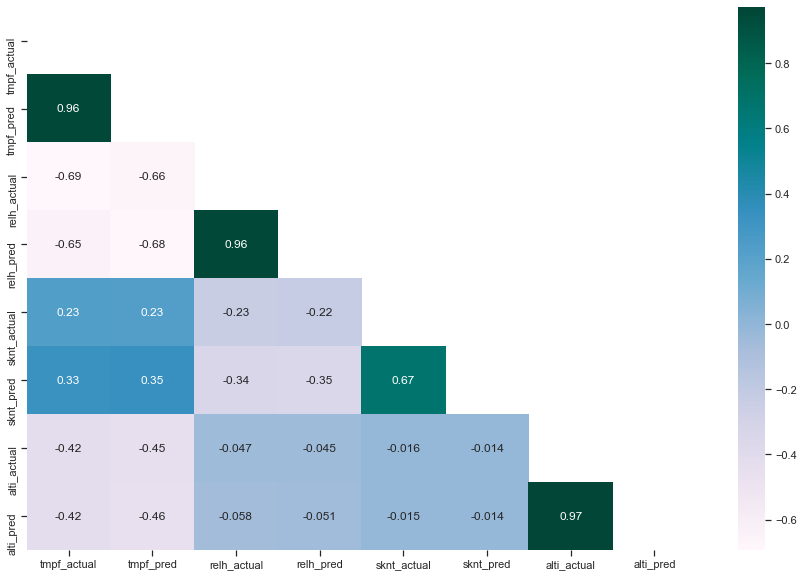

In [111]:
plt.figure(figsize=(15,10))
matrix = results.corr()
mask = np.triu(np.ones_like(matrix, dtype=bool))
sns.heatmap(matrix, mask=mask, annot=True,cmap='PuBuGn')

* **Air Temperature [°F]**

Text(0, 0.5, 'Frequency')

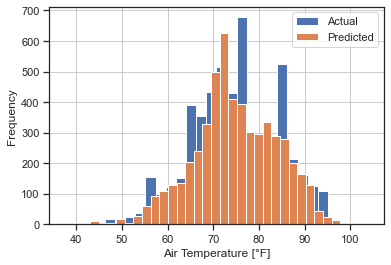

In [101]:
results.tmpf_actual.hist(bins=30)
results.tmpf_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Air Temperature [°F]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Air Temperature [°F]')

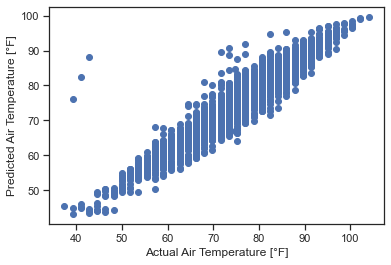

In [102]:
plt.scatter(results.tmpf_actual,results.tmpf_pred, c='b')
plt.xlabel('Actual Air Temperature [°F]')
plt.ylabel('Predicted Air Temperature [°F]')

* **Relative Humidity [%]**

Text(0, 0.5, 'Frequency')

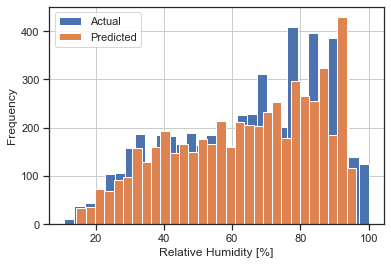

In [103]:
results.relh_actual.hist(bins=30)
results.relh_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Relative Humidity [%]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Relative Humidity [%]')

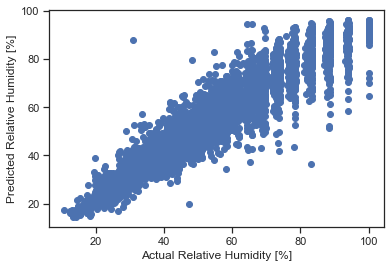

In [105]:
plt.scatter(results.relh_actual,results.relh_pred, c='b')
plt.xlabel('Actual Relative Humidity [%]')
plt.ylabel('Predicted Relative Humidity [%]')

* **Windspeed [knots]**

Text(0, 0.5, 'Frequency')

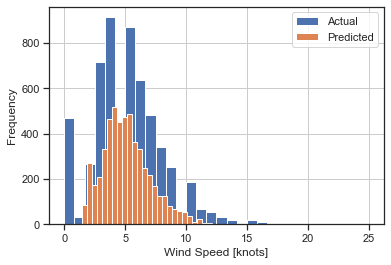

In [106]:
results.sknt_actual.hist(bins=30)
results.sknt_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Wind Speed [knots]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Wind Speed [knots]')

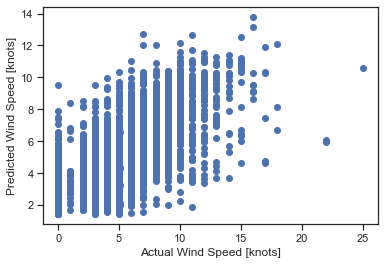

In [107]:
plt.scatter(results.sknt_actual,results.sknt_pred, c='b')
plt.xlabel('Actual Wind Speed [knots]')
plt.ylabel('Predicted Wind Speed [knots]')

* **Pressure Altimeter [inches]**

Text(0, 0.5, 'Frequency')

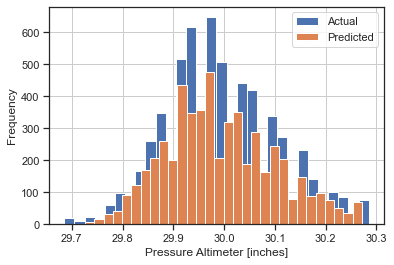

In [108]:
results.alti_actual.hist(bins=30)
results.alti_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Pressure Altimeter [inches]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Pressure Altimeter [inches]')

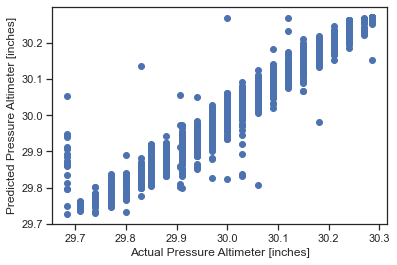

In [110]:
plt.scatter(results.alti_actual,results.alti_pred, c='b')
plt.xlabel('Actual Pressure Altimeter [inches]')
plt.ylabel('Predicted Pressure Altimeter [inches]')

* **Residuals DataFrame**

In [141]:
residuals = pd.DataFrame({'residuals_tmpf':results.tmpf_pred - results.tmpf_actual,
                          'residuals_relh':results.relh_pred - results.relh_actual,
                          'residuals_sknt':results.sknt_pred - results.sknt_actual,
                          'residuals_alti':results.alti_pred - results.alti_actual,
                        })
residuals

,residuals_tmpf,residuals_relh,residuals_sknt,residuals_alti
40105,-0.478934,1.239817,1.664178,0.006600
41480,-0.233197,1.503234,2.170851,-0.014168
30323,-2.214906,9.089747,-4.447194,0.022436
42010,-0.252853,0.619796,-1.209773,-0.000918
4758,0.324735,3.431737,-0.739711,0.042260
...,...,...,...,...
40816,-0.443861,-3.707101,-2.877775,-0.011146
20897,-1.919714,4.830284,-4.810413,0.020646
13633,1.859086,-3.988920,1.372391,0.006408
14365,1.387177,-6.273689,-1.948322,-0.004341


Text(0.5, 0, 'Value')

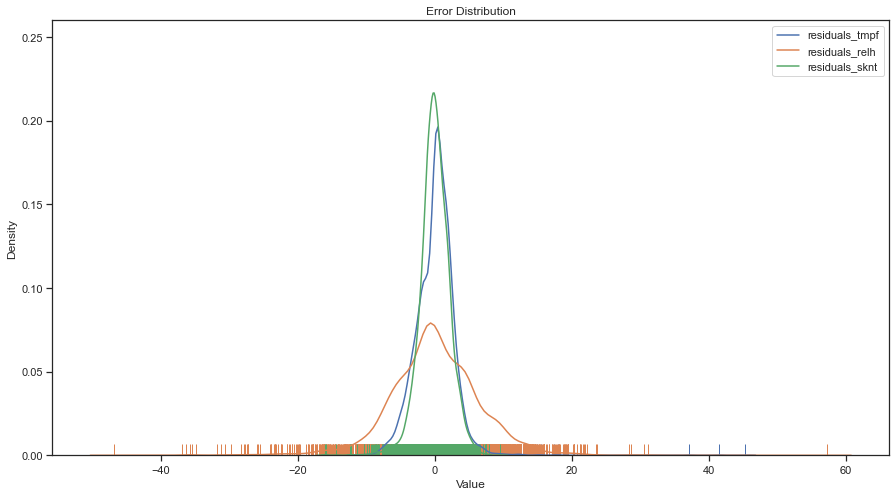

In [170]:
plt.figure(figsize=(15,8))
plt.title('Error Distribution')
sns.distplot(residuals.residuals_tmpf,hist=False,bins=50,rug=True)
sns.distplot(residuals.residuals_relh,hist=False,bins=50,rug=True)
sns.distplot(residuals.residuals_sknt,hist=False,bins=50,rug=True)
plt.legend(['residuals_tmpf','residuals_relh','residuals_sknt'])
plt.xlabel('Value')


Text(0.5, 0, 'Value')

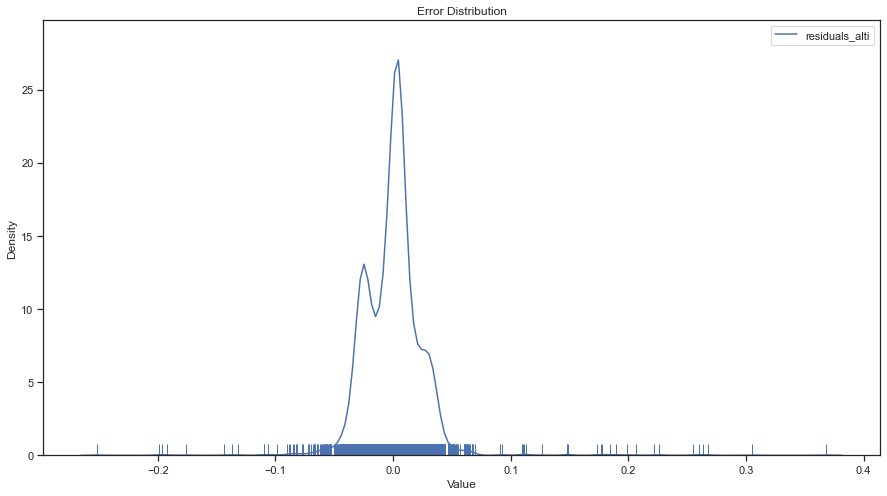

In [171]:
plt.figure(figsize=(15,8))
plt.title('Error Distribution')
sns.distplot(residuals.residuals_alti,hist=False,bins=50,rug=True)
plt.legend(['residuals_alti'])
plt.xlabel('Value')

### (viii) Model Interpretability

In [112]:
from sklearn.tree import export_graphviz
import random

y_col_random = random.randint(0, y.shape[1]-1) #selects a random column (y) for visualization
print(f'Selected y: {y.columns[y_col_random]}')
x_var, y_var = X_train, y_train.values[:,y_col_random]

model = GradientBoostingRegressor(n_estimators=700,min_samples_split=2,min_impurity_decrease=0,
                                                           max_leaf_nodes=10,max_depth=3,learning_rate=0.01,
                                                           criterion='friedman_mse').fit(x_var, y_var)

# Get the tree number
random_tree_number = random.randint(0,100) # selects a random tree number for visualization
print(f'Selected tree: {random_tree_number}')
sub_tree = model.estimators_[random_tree_number, 0]

# Visualization
# Install graphviz: https://www.graphviz.org/download/
from pydotplus import graph_from_dot_data
from IPython.display import Image
dot_data = export_graphviz(
    sub_tree,
    out_file=None, filled=True, rounded=True,
    special_characters=True,
    proportion=False, impurity=False, # enable them if you want
    feature_names = list(X.columns)
)
graph = graph_from_dot_data(dot_data)
Image(graph.create_png())

Selected y: sknt
Selected tree: 13


InvocationException: GraphViz's executables not found

In [116]:
!pip install shap

In [117]:
# https://github.com/slundberg/shap
import shap

* **tmpf**

In [121]:
x_var, y_var = X_train, y_train.values[:,0]

model = GradientBoostingRegressor(n_estimators=700,min_samples_split=2,min_impurity_decrease=0,
                                                           max_leaf_nodes=10,max_depth=3,learning_rate=0.01,
                                                           criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [122]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

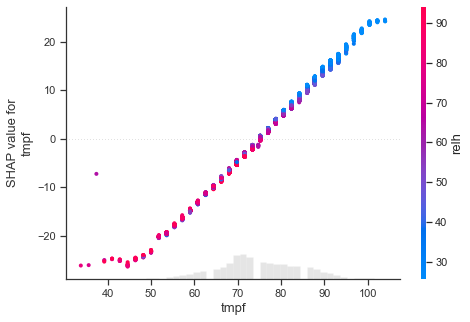

In [123]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

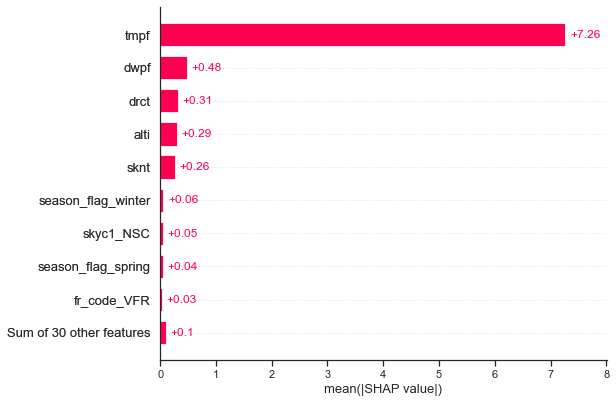

In [124]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

* **relh**

In [125]:
x_var, y_var = X_train, y_train.values[:,1]

model = GradientBoostingRegressor(n_estimators=700,min_samples_split=2,min_impurity_decrease=0,
                                                           max_leaf_nodes=10,max_depth=3,learning_rate=0.01,
                                                           criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [126]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

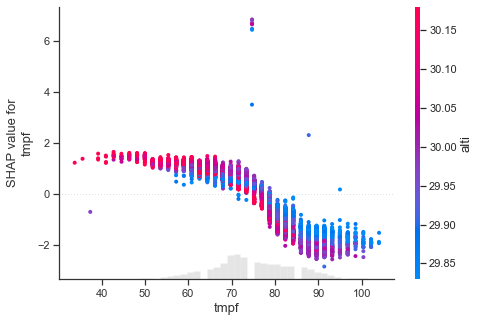

In [127]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

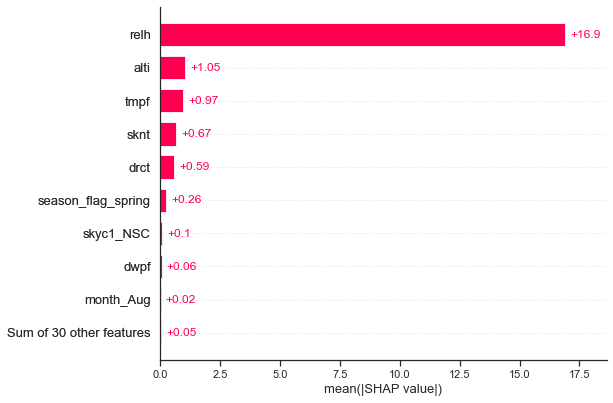

In [128]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

* **sknt**

In [130]:
x_var, y_var = X_train, y_train.values[:,2]

model = GradientBoostingRegressor(n_estimators=700,min_samples_split=2,min_impurity_decrease=0,
                                                           max_leaf_nodes=10,max_depth=3,learning_rate=0.01,
                                                           criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [131]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

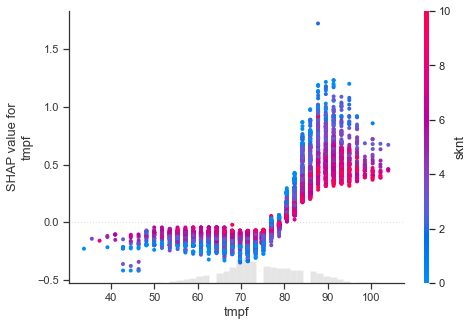

In [132]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

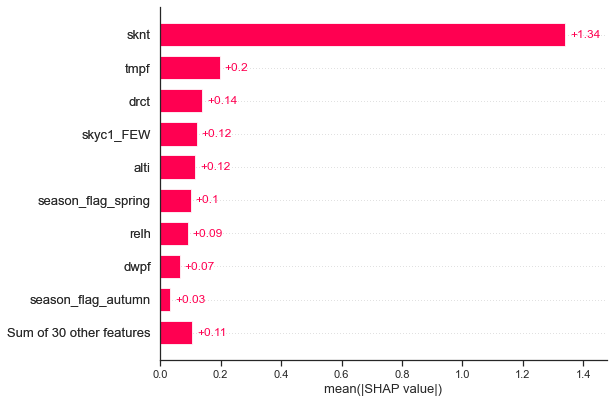

In [133]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

* **alti**

In [136]:
x_var, y_var = X_train, y_train.values[:,3]

model = GradientBoostingRegressor(n_estimators=700,min_samples_split=2,min_impurity_decrease=0,
                                                           max_leaf_nodes=10,max_depth=3,learning_rate=0.01,
                                                           criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [137]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

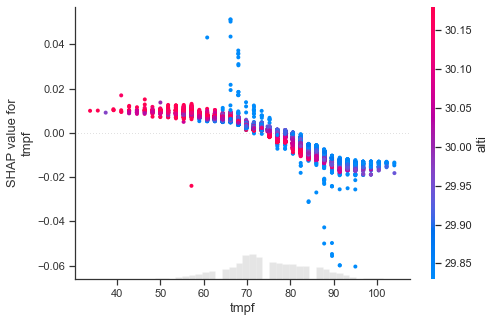

In [138]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

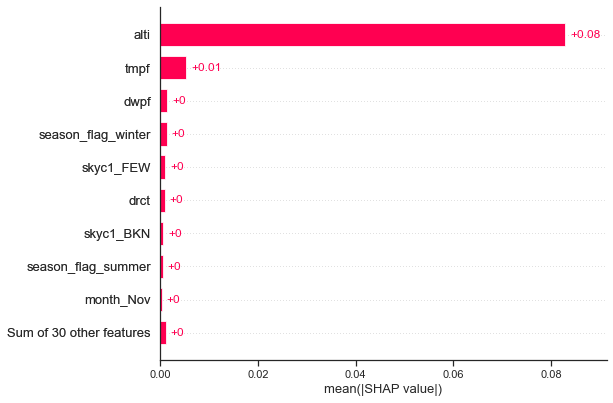

In [139]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

# Exporting the model

In [41]:
import joblib
filename = 'METAR.joblib'
joblib.dump(reg_model, filename)

['METAR.joblib']

In [45]:
# Verifying the loaded file
filename = 'METAR.joblib'
loaded_model = joblib.load(filename)
loaded_model

MultiOutputRegressor(estimator=GradientBoostingRegressor(learning_rate=0.01,
                                                         max_leaf_nodes=20,
                                                         min_impurity_decrease=0,
                                                         n_estimators=700))

In [47]:
X.iloc[[5]].values

array([[ 75.2 ,  69.8 ,  83.32, 120.  ,   5.  ,  29.91,   0.  ,   1.  ,
          0.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,
          1.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,
          0.  ,   0.  ,   1.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,
          0.  ,   1.  ,   0.  ,   0.  ,   0.  ,   0.  ,   1.  ]])

In [46]:
# Checking model's response
model_input = X.iloc[[5]].values
model_output = loaded_model.predict(model_input)
model_output

array([[75.22036481, 83.13493953,  4.58104283, 29.91592057]])